# **Part A: Convolutional Neural Network (CNN)**
<h5>
Name: Shaun Kwo Rui Yu
</br>Class: DAAA/FT/2A/03
</br>Adm No.: 2317933</h5>

--- 


### **The main objective of this assignment is to:**
Implement an image classifier using a deep learning network for color images of 224 by 224 pixels, containing 15 types of vegetables. 

Convert the images into grayscale with two different input sizes: 
1. 37 by 37 pixels 
2. 131 by 131 pixels.

### **Research and Background**
- **CNNs in Image Classification:** Convolutional Neural Networks (CNNs) are widely used in image classification tasks due to their ability to automatically learn features from images.
- **Data Augmentation:** Augmenting the dataset with variations of images can help improve model generalization and robustness.
- **Grayscale Conversion:** Converting color images to grayscale reduces the dimensionality of the input data while retaining essential features for classification.

Cited from ChatGPT

### **Additional Information:**
**There are many ways to improve the model's performance** like **accuracy being one of the main metrics** such as:
- Improving performance by data
- Improving Performance With Algorithms.
- Improving Performance With Algorithm Tuning.
- Improving Performance With Ensembles.

Cited from: https://machinelearningmastery.com/improve-deep-learning-performance/

---
### **EDA and Preprocessing**
- **Exploratory Data Analysis (EDA):** Analyze the dataset to understand the distribution of vegetable images, class imbalances, and data quality issues.
- **Image Preprocessing:** Convert color images to grayscale and resize them to the specified input sizes (37x37 and 131x131 pixels) for model training.

### **Model Architecture and Training**
- **CNN Architecture:** Design CNN architectures suitable for image classification, including convolutional layers, pooling layers, activation functions (e.g., ReLU), and fully connected layers.
- **Hyperparameter Tuning:** Fine-tune hyperparameters such as learning rate, batch size, and optimizer choice (e.g., Adam, SGD) for optimal model performance.
- **Data Augmentation:** Apply data augmentation techniques (e.g., rotation, flipping) to generate additional training data and improve model generalization.

### **Evaluation and Comparison**
- **Model Evaluation:** Evaluate the trained CNN models using validation data and metrics like accuracy, precision, recall, and F1 score.
- **Comparison of Input Sizes:** Compare and discuss the classification accuracies achieved for each input size (37x37 vs. 131x131 pixels) to analyze the impact of image resolution on model performance.



<hr>
<h3>Importing Libraries</h3>
<hr></hr>

In [2]:
# Basic libraries
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
# import warnings
import warnings
# filter warnings
warnings.filterwarnings('ignore')
import PIL
import PIL.Image as Image
from pathlib import Path
import shutil
import glob


# Importing Tensorflow Libraries
import tensorflow as tf
from keras.preprocessing.image import ImageDataGenerator
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from keras.preprocessing import image
from keras.optimizers import Adam, RMSprop
from keras.callbacks import ModelCheckpoint, EarlyStopping
from keras.models import load_model
from keras_tuner.tuners import RandomSearch
from keras.regularizers import l2 

#  Importing Scikit learn libraries
from sklearn.utils.class_weight import compute_class_weight
from sklearn.metrics import confusion_matrix


<hr></hr>
<h3>Exploratory Data Analysis (EDA)</h3>
<hr></hr>

In [2]:
# Finding size of each dataset (train, test, validation)
def get_dataset_size(path):
    data_dir = Path(f'./Dataset for CA1 part A - AY2425S1/{path}')
    # Count the number of .jpg files in the dataset
    image_files = list(data_dir.glob('**/*.jpg'))
    image_count = len(image_files)

    print(f'Total number of image files in the {path} dataset: {image_count}')
    return image_count

train_size= get_dataset_size('train')
test_size= get_dataset_size('test')
validation_size= get_dataset_size('validation')

dataset_size=train_size+test_size+validation_size
print(f'Total images found in the whole dataset: {dataset_size}')



Total number of image files in the train dataset: 9043
Total number of image files in the test dataset: 3000
Total number of image files in the validation dataset: 3000
Total images found in the whole dataset: 15043


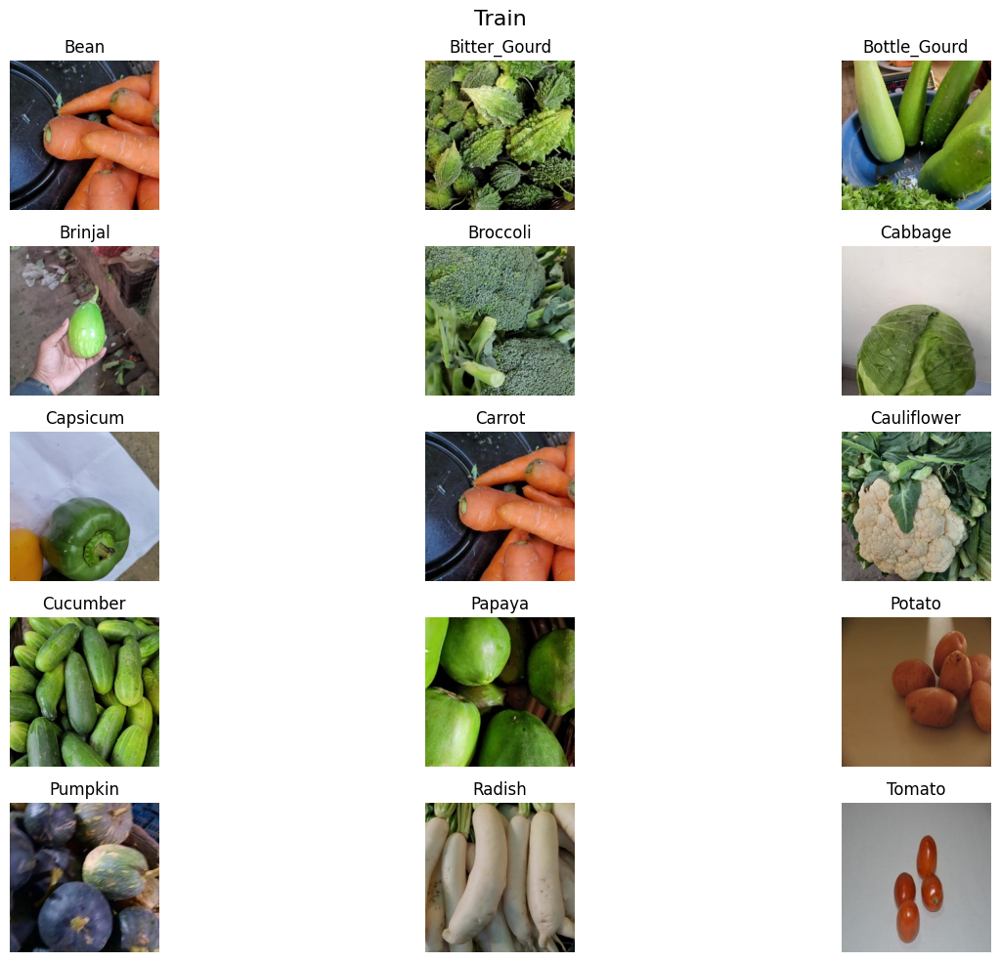

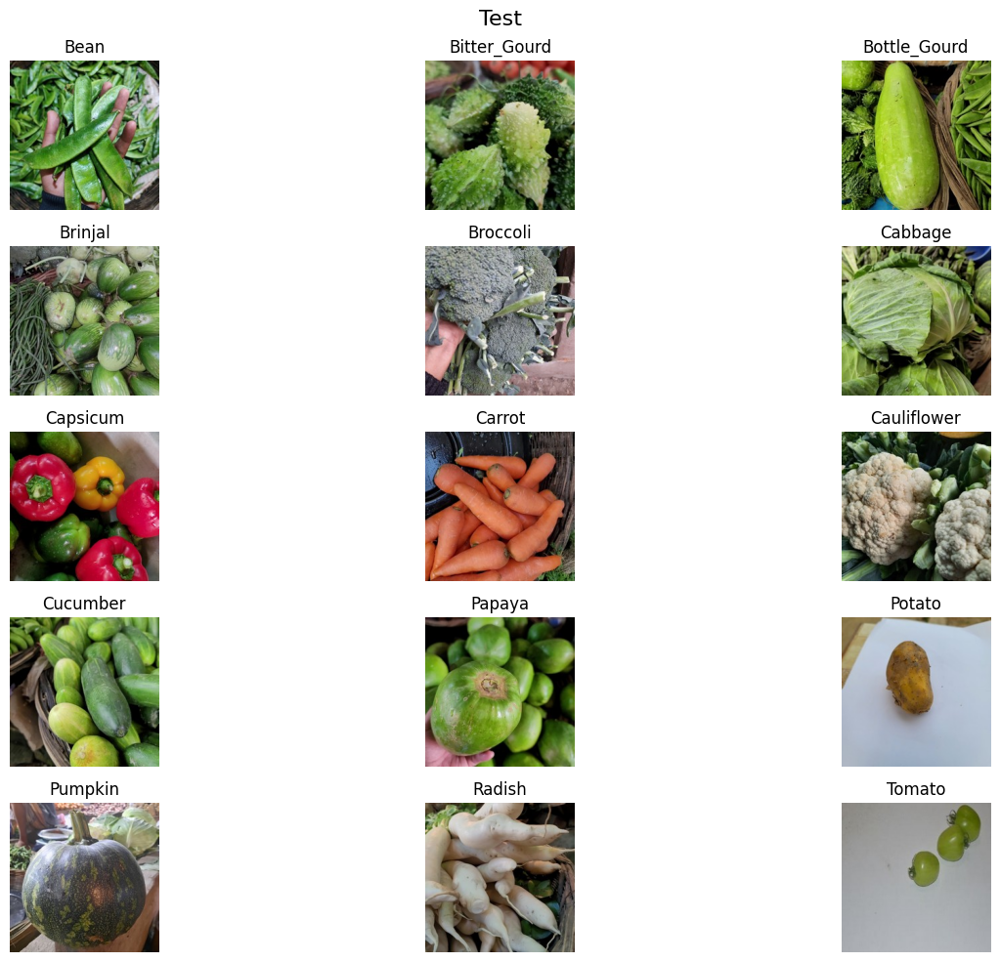

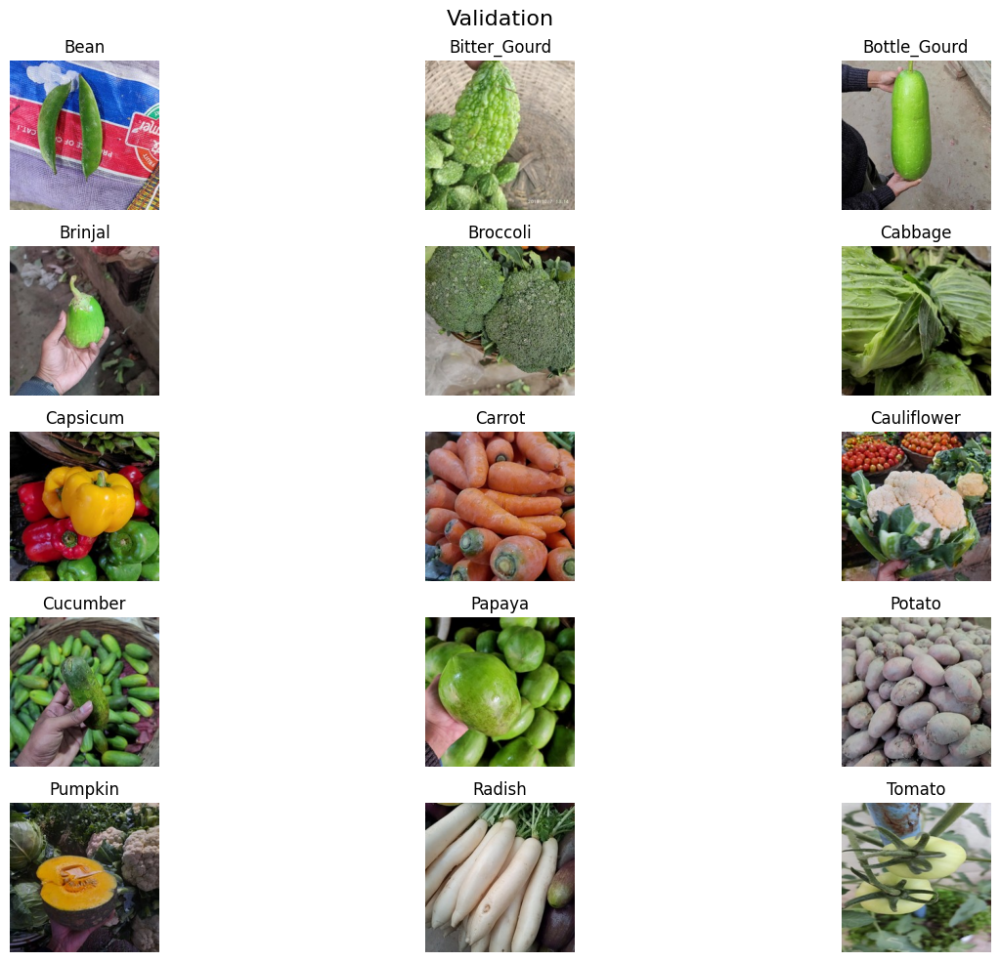

In [3]:
def plot_images(directory, title):
    fig, axs = plt.subplots(5, 3, figsize=(15, 10))
    fig.suptitle(title, fontsize=16)

    for idx, subdir in enumerate(directory.iterdir()):
        images = list(subdir.glob('*.jpg'))[:1]  # Get the first image
        for image_path in images:
            image = Image.open(str(image_path))
            ax = axs[idx // 3, idx % 3]
            ax.imshow(image)
            ax.axis('off')  # Hide axes
            ax.set_title(subdir.name)

    plt.tight_layout()
    plt.show()

# Define the directories for train, test, and validation datasets
train_dir = Path('./Dataset for CA1 part A - AY2425S1/train')
test_dir = Path('./Dataset for CA1 part A - AY2425S1/test')
validation_dir = Path('./Dataset for CA1 part A - AY2425S1/validation')

# Plot the first images in each directory
plot_images(train_dir, 'Train')
plot_images(test_dir, 'Test')
plot_images(validation_dir, 'Validation')

# cited from Chatgpt

### Visualising First Pictures of `train`,`test` and `validation` datasets

---

We can already spot a problem in the `Bean` picture of the `train` dataset 

where it is an image of a `carrot` instead a `Bean`

This can be removed to improve the accuracy of the model during model improvement later

#### More specific Additional Infomation on improving model with data by:
- Invent More Data
- Rescale Your Data
- Transform Your Data (flipping and rotating them)
- Feature Selection (Deleting Images)
---
Cited from: https://machinelearningmastery.com/improve-deep-learning-performance/

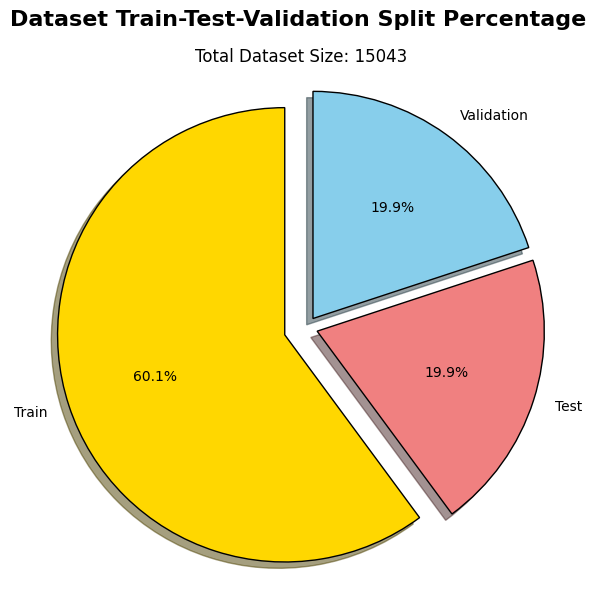

In [4]:
import matplotlib.pyplot as plt

# Calculate split percentages
train_percentage = (train_size / dataset_size) * 100
test_percentage = (test_size / dataset_size) * 100
validation_percentage = (validation_size / dataset_size) * 100


# Pie chart of train test split datasets
plt.figure(figsize=(6,6))
plt.pie([train_percentage, test_percentage, validation_percentage],
        labels=['Train', 'Test', 'Validation'], 
        colors=['gold', 'lightcoral', 'skyblue'], 
        autopct='%1.1f%%', startangle=90, explode=(0.1, 0.05, 0.05),
        shadow=True, wedgeprops={'edgecolor': 'black', 'linewidth': 1})
plt.suptitle('Dataset Train-Test-Validation Split Percentage', fontsize=16, fontweight='bold')
plt.title(f'Total Dataset Size: {dataset_size}', fontsize=12)
plt.axis('equal')
plt.tight_layout()
plt.show()



### From the Pie Chart above, we can see that 
The ratio of **`train`: `test`: `validation`** is **60  :  20   :  20** which is a well balanced ratio of the dataset for model creation.


In [5]:
def images_per_file(file):
    # Initialize a dictionary to store the count of .jpg files in each folder
    jpg_counts = {}

    # Traverse through each folder in the directory
    for root, dirs, files in os.walk(f'./Dataset for CA1 part A - AY2425S1/{file}'):
        # Count the number of .jpg files in the current folder
        jpg_files = [file for file in files if file.lower().endswith('.jpg')]
        jpg_count = len(jpg_files)
        
        # Store the count in the dictionary using the folder name as the key
        folder_name = os.path.basename(root)
        jpg_counts[folder_name] = jpg_count
    
    # Create variables for each folder count
    for folder, count in jpg_counts.items():+
        globals()[f"{file}_{folder}"] = count  # Create variable with name {file}_{folder}
    
    # Print the count of .jpg files in each folder
    for folder, count in jpg_counts.items():
        print(f" {file}_{folder} has {count} .jpg file(s).")
    print('\n\n')

# Call the function for 'train', 'test', and 'validation' folders
images_per_file('train')
images_per_file('test')
images_per_file('validation')


 train_train has 0 .jpg file(s).
 train_Bean has 795 .jpg file(s).
 train_Bitter_Gourd has 720 .jpg file(s).
 train_Bottle_Gourd has 441 .jpg file(s).
 train_Brinjal has 868 .jpg file(s).
 train_Broccoli has 750 .jpg file(s).
 train_Cabbage has 503 .jpg file(s).
 train_Capsicum has 351 .jpg file(s).
 train_Carrot has 256 .jpg file(s).
 train_Cauliflower has 587 .jpg file(s).
 train_Cucumber has 812 .jpg file(s).
 train_Papaya has 566 .jpg file(s).
 train_Potato has 377 .jpg file(s).
 train_Pumpkin has 814 .jpg file(s).
 train_Radish has 248 .jpg file(s).
 train_Tomato has 955 .jpg file(s).



 test_test has 0 .jpg file(s).
 test_Bean has 200 .jpg file(s).
 test_Bitter_Gourd has 200 .jpg file(s).
 test_Bottle_Gourd has 200 .jpg file(s).
 test_Brinjal has 200 .jpg file(s).
 test_Broccoli has 200 .jpg file(s).
 test_Cabbage has 200 .jpg file(s).
 test_Capsicum has 200 .jpg file(s).
 test_Carrot has 200 .jpg file(s).
 test_Cauliflower has 200 .jpg file(s).
 test_Cucumber has 200 .jpg file(

In [6]:
# Calculate percentages for each vegetable based on counts and dataset size
train_Bean_percentage = (train_Bean / train_size) * 100
train_Bitter_Gourd_percentage = (train_Bitter_Gourd / train_size) * 100
train_Bottle_Gourd_percentage = (train_Bottle_Gourd / train_size) * 100
train_Brinjal_percentage = (train_Brinjal / train_size) * 100
train_Broccoli_percentage = (train_Broccoli / train_size) * 100
train_Cabbage_percentage = (train_Cabbage / train_size) * 100
train_Capsicum_percentage = (train_Capsicum / train_size) * 100
train_Carrot_percentage = (train_Carrot / train_size) * 100
train_Cauliflower_percentage = (train_Cauliflower / train_size) * 100
train_Cucumber_percentage = (train_Cucumber / train_size) * 100
train_Papaya_percentage = (train_Papaya / train_size) * 100
train_Potato_percentage = (train_Potato / train_size) * 100
train_Pumpkin_percentage = (train_Pumpkin / train_size) * 100
train_Radish_percentage = (train_Radish / train_size) * 100
train_Tomato_percentage = (train_Tomato / train_size) * 100


In [7]:
# Calculate percentages for each vegetable based on counts and dataset size
test_Bean_percentage = (test_Bean / test_size) * 100
test_Bitter_Gourd_percentage = (test_Bitter_Gourd / test_size) * 100
test_Bottle_Gourd_percentage = (test_Bottle_Gourd / test_size) * 100
test_Brinjal_percentage = (test_Brinjal / test_size) * 100
test_Broccoli_percentage = (test_Broccoli / test_size) * 100
test_Cabbage_percentage = (test_Cabbage / test_size) * 100
test_Capsicum_percentage = (test_Capsicum / test_size) * 100
test_Carrot_percentage = (test_Carrot / test_size) * 100
test_Cauliflower_percentage = (test_Cauliflower / test_size) * 100
test_Cucumber_percentage = (test_Cucumber / test_size) * 100
test_Papaya_percentage = (test_Papaya / test_size) * 100
test_Potato_percentage = (test_Potato / test_size) * 100
test_Pumpkin_percentage = (test_Pumpkin / test_size) * 100
test_Radish_percentage = (test_Radish / test_size) * 100
test_Tomato_percentage = (test_Tomato / test_size) * 100


In [8]:
# Calculate percentages for each vegetable based on counts and dataset size
validation_Bean_percentage = (validation_Bean / validation_size) * 100
validation_Bitter_Gourd_percentage = (validation_Bitter_Gourd / validation_size) * 100
validation_Bottle_Gourd_percentage = (validation_Bottle_Gourd / validation_size) * 100
validation_Brinjal_percentage = (validation_Brinjal / validation_size) * 100
validation_Broccoli_percentage = (validation_Broccoli / validation_size) * 100
validation_Cabbage_percentage = (validation_Cabbage / validation_size) * 100
validation_Capsicum_percentage = (validation_Capsicum / validation_size) * 100
validation_Carrot_percentage = (validation_Carrot / validation_size) * 100
validation_Cauliflower_percentage = (validation_Cauliflower / validation_size) * 100
validation_Cucumber_percentage = (validation_Cucumber / validation_size) * 100
validation_Papaya_percentage = (validation_Papaya / validation_size) * 100
validation_Potato_percentage = (validation_Potato / validation_size) * 100
validation_Pumpkin_percentage = (validation_Pumpkin / validation_size) * 100
validation_Radish_percentage = (validation_Radish / validation_size) * 100
validation_Tomato_percentage = (validation_Tomato / validation_size) * 100


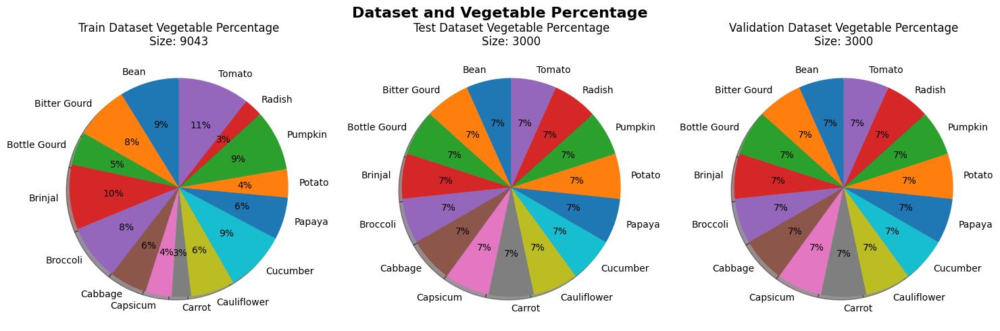

In [9]:
# Create subplots for the pie charts
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

# Define labels and values for the vegetable pie charts
vegetable_labels = ['Bean', 'Bitter Gourd', 'Bottle Gourd', 'Brinjal', 'Broccoli', 'Cabbage', 'Capsicum', 'Carrot',
                    'Cauliflower', 'Cucumber', 'Papaya', 'Potato', 'Pumpkin', 'Radish', 'Tomato']

train_vegetable_sizes = [train_Bean_percentage, train_Bitter_Gourd_percentage, train_Bottle_Gourd_percentage,
                          train_Brinjal_percentage, train_Broccoli_percentage, train_Cabbage_percentage,
                          train_Capsicum_percentage, train_Carrot_percentage, train_Cauliflower_percentage,
                          train_Cucumber_percentage, train_Papaya_percentage, train_Potato_percentage,
                          train_Pumpkin_percentage, train_Radish_percentage, train_Tomato_percentage]

test_vegetable_sizes = [test_Bean_percentage, test_Bitter_Gourd_percentage, test_Bottle_Gourd_percentage,
                         test_Brinjal_percentage, test_Broccoli_percentage, test_Cabbage_percentage,
                         test_Capsicum_percentage, test_Carrot_percentage, test_Cauliflower_percentage,
                         test_Cucumber_percentage, test_Papaya_percentage, test_Potato_percentage,
                         test_Pumpkin_percentage, test_Radish_percentage, test_Tomato_percentage]

validation_vegetable_sizes = [validation_Bean_percentage, validation_Bitter_Gourd_percentage,
                              validation_Bottle_Gourd_percentage, validation_Brinjal_percentage,
                              validation_Broccoli_percentage, validation_Cabbage_percentage,
                              validation_Capsicum_percentage, validation_Carrot_percentage,
                              validation_Cauliflower_percentage, validation_Cucumber_percentage,
                              validation_Papaya_percentage, validation_Potato_percentage,
                              validation_Pumpkin_percentage, validation_Radish_percentage,
                              validation_Tomato_percentage]

# Plot the vegetable pie charts for train, test, and validation datasets
axs[0].pie(train_vegetable_sizes, labels=vegetable_labels, autopct='%1.0f%%', startangle=90, shadow=True)
axs[0].set_title(f'Train Dataset Vegetable Percentage\nSize: {train_size}', fontsize=12)

axs[1].pie(test_vegetable_sizes, labels=vegetable_labels, autopct='%1.0f%%', startangle=90, shadow=True)
axs[1].set_title(f'Test Dataset Vegetable Percentage\nSize: {test_size}', fontsize=12)

axs[2].pie(validation_vegetable_sizes, labels=vegetable_labels, autopct='%1.0f%%', startangle=90, shadow=True)
axs[2].set_title(f'Validation Dataset Vegetable Percentage\nSize: {validation_size}', fontsize=12)

# Add a common suptitle
plt.suptitle('Dataset and Vegetable Percentage', fontsize=16, fontweight='bold')

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


### Feature engineering and data augmentation
---
#### Feature engineering is the process of creating new features, modifying existing features or removing duplicated features in a dataset to improve the performance of machine learning models.

- Removing repeated images for this case as there are file with '- Copy' should be removed because

    1. **Rendundency Reduction:** Removing duplicate data points reduces redundancy in the dataset. Redundant data does not provide additional information to the model but can increase computational overhead during training.
    2. **Data Quality Enhancement:** Feature engineering aims to improve the quality of input data for machine learning models. Removing duplicate data contributes to data cleaning, which is an essential aspect of data quality. 
    3. **Model Performance:** Ultimately, the goal of feature engineering, including duplicate removal, is to enhance the model's performance. By providing the model with cleaner, non-redundant data, it improve the model's ability to learn meaningful patterns and make accurate predictions on new data.

#### Data augmentation enhances training data diversity for machine learning models
#### which can be by adding more images from pre-existing images

Examples are:

- **Grayscaling:** Creating new modified gray versions of photos from the original photos 
which use Red, Green, Blue (RGB) color schemes.

Greyscaling uses these formulas below:

$$ \text{Average Method: } \text{gray} = \frac{R + G + B}{3} $$

$$ \text{Luminosity Method: } \text{gray} = 0.21R + 0.72G + 0.07B $$

$$ \text{Lightness Method: } \text{gray} = \frac{\max(R, G, B) + \min(R, G, B)}{2} $$

- **Flipping and rotating the image** is also another form of data augmentation as it make more new images out of previous images
- **Resizing pixel size of images** 


#### Feature Engineering 
---

**Removing duplicated images from dataset and storing them in another folder called `duplicates`**
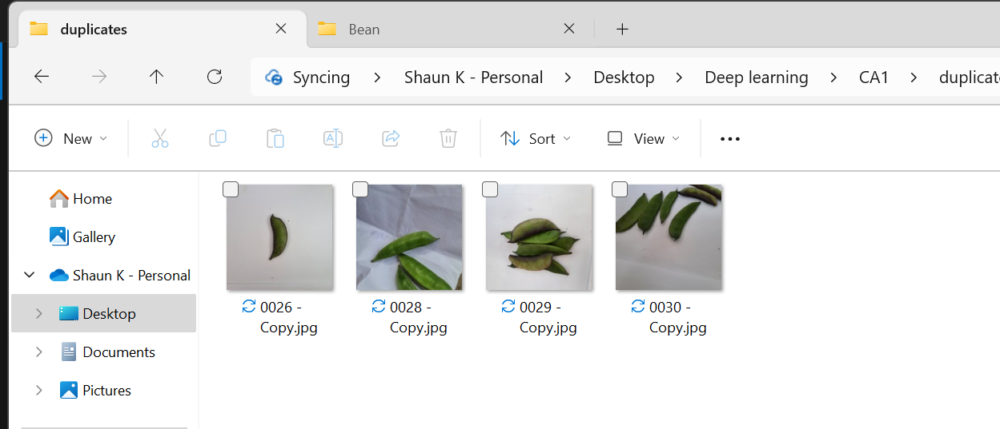

In [10]:
import os

# Define the directory paths for train, test, and validation sets
train_dir = './Cleaned Dataset for CA1 part A - AY2425S1/train'
test_dir = './Cleaned Dataset for CA1 part A - AY2425S1/test'
validation_dir = './Cleaned Dataset for CA1 part A - AY2425S1/validation'


<b> In `train`, `Bean dataset`, there are `Carrot images` so
I will remove `Carrot` images from `Bean` dataset</b>

as carrots and beans may have visual similarities or shared characteristics, such as color or shape. 

Keeping carrot images in the bean dataset could confuse the model, leading to misclassifications or reduced accuracy in bean recognition tasks.

#### <u>Before removing `Carrot` images from `Bean` file in train</u>
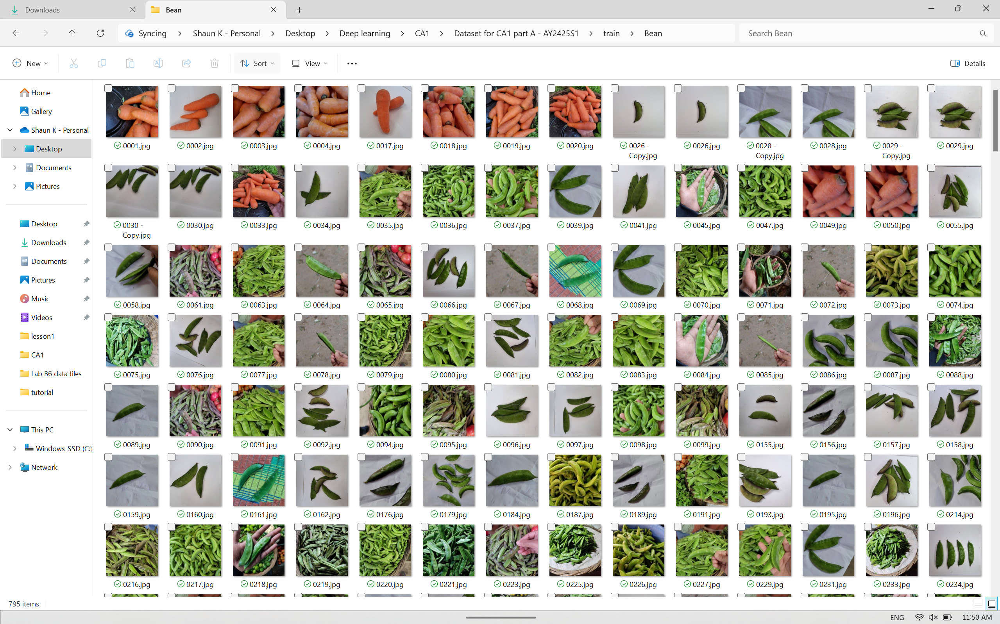

#### <u>Remove selected photos</u> 
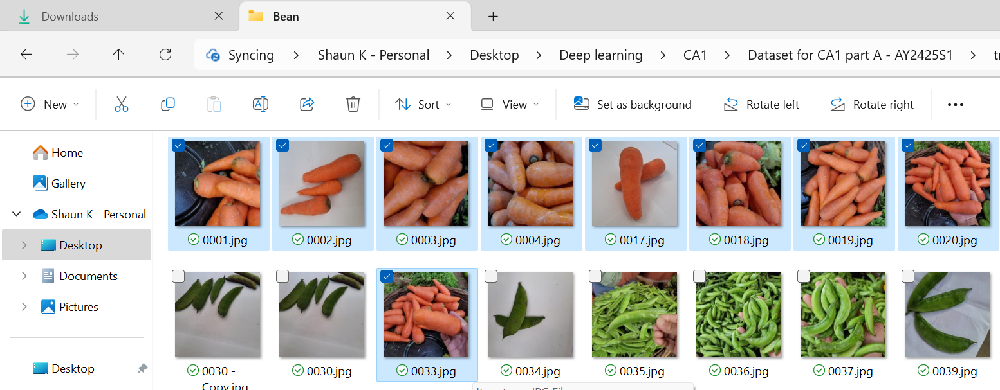

####  <u>After removing `Carrot` images from `Bean` file in train</u>
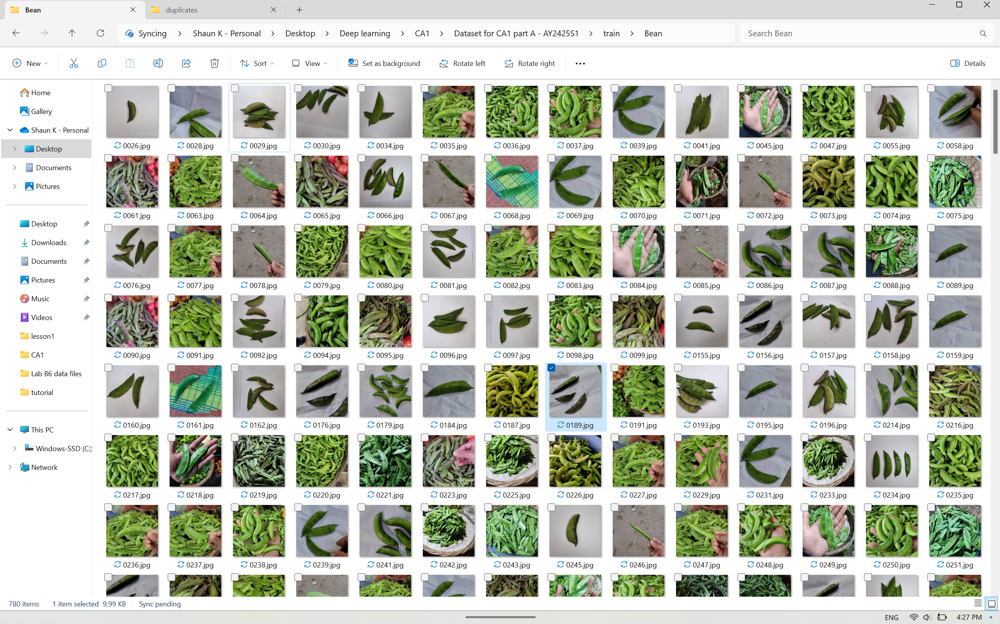

#### Data Augmentation
---

In [11]:
def process_images(base_directory, output_directory, directories, resize_dimensions=(37,37)):
    def count_jpg_files_in_directory(directory):
        # Join the directory path with the file pattern
        file_pattern = os.path.join(directory, '*.jpg')
        
        # Use glob to find files matching the pattern
        jpg_files = glob.glob(file_pattern)
        
        # Count the number of JPG files found
        return len(jpg_files)

    def convert_and_resize_image(image_path, output_path, dimensions):
        # Open the image using PIL
        img = Image.open(image_path)
        
        # Convert the image to grayscale
        img_gray = img.convert('L')
        
        # Resize the image to the specified dimensions
        img_resized = img_gray.resize(dimensions)
        
        # Save the resized image
        img_resized.save(output_path)
    
    os.makedirs(output_directory, exist_ok=True)
    
    for directory in directories:
        directory_path = os.path.join(base_directory, directory)
        num_jpg_files = count_jpg_files_in_directory(directory_path)
        print(f"Processing {num_jpg_files} .jpg files in {directory}")
        
        output_vegetable_directory = os.path.join(output_directory, directory)
        os.makedirs(output_vegetable_directory, exist_ok=True)
        
        for jpg_file in glob.glob(os.path.join(directory_path, '*.jpg')):
            filename = os.path.splitext(os.path.basename(jpg_file))[0]
            output_path = os.path.join(output_vegetable_directory, f"{filename}.jpg")
            
            convert_and_resize_image(jpg_file, output_path, resize_dimensions)
    
    print(f"All images processed and saved in {output_directory} directory.\n\n")

directories = ['Bean', 'Bitter_Gourd', 'Bottle_Gourd', 'Brinjal', 'Broccoli',
                'Cabbage', 'Capsicum', 'Carrot', 'Cauliflower', 'Cucumber',
                  'Papaya', 'Potato', 'Pumpkin', 'Radish', 'Tomato']


base_directory_train = './Cleaned Dataset for CA1 part A - AY2425S1/train'
directory_train='./Cleaned Dataset for CA1 part A - AY2425S1/train37'
process_images(base_directory_train, directory_train, directories)

base_directory_test = './Cleaned Dataset for CA1 part A - AY2425S1/test'
directory_test='./Cleaned Dataset for CA1 part A - AY2425S1/test37'
process_images(base_directory_test, directory_test, directories)

base_directory_validation = './Cleaned Dataset for CA1 part A - AY2425S1/validation'
directory_validation='./Cleaned Dataset for CA1 part A - AY2425S1/validation37'
process_images(base_directory_validation, directory_validation, directories)

Processing 780 .jpg files in Bean
Processing 720 .jpg files in Bitter_Gourd
Processing 441 .jpg files in Bottle_Gourd
Processing 868 .jpg files in Brinjal
Processing 750 .jpg files in Broccoli
Processing 503 .jpg files in Cabbage
Processing 351 .jpg files in Capsicum
Processing 256 .jpg files in Carrot
Processing 587 .jpg files in Cauliflower
Processing 812 .jpg files in Cucumber
Processing 566 .jpg files in Papaya
Processing 377 .jpg files in Potato
Processing 814 .jpg files in Pumpkin
Processing 248 .jpg files in Radish
Processing 955 .jpg files in Tomato
All images processed and saved in ./Cleaned Dataset for CA1 part A - AY2425S1/train37 directory.


Processing 200 .jpg files in Bean
Processing 200 .jpg files in Bitter_Gourd
Processing 200 .jpg files in Bottle_Gourd
Processing 200 .jpg files in Brinjal
Processing 200 .jpg files in Broccoli
Processing 200 .jpg files in Cabbage
Processing 200 .jpg files in Capsicum
Processing 200 .jpg files in Carrot
Processing 200 .jpg files in Caul

In [12]:
import os
import glob
from PIL import Image

def process_images(base_directory, output_directory, directories, resize_dimensions=(131,131)):
    def count_jpg_files_in_directory(directory):
        # Join the directory path with the file pattern
        file_pattern = os.path.join(directory, '*.jpg')
        
        # Use glob to find files matching the pattern
        jpg_files = glob.glob(file_pattern)
        
        # Count the number of JPG files found
        return len(jpg_files)

    def convert_and_resize_image(image_path, output_path, dimensions):
        # Open the image using PIL
        img = Image.open(image_path)
        
        # Convert the image to grayscale
        img_gray = img.convert('L')
        
        # Resize the image to the specified dimensions
        img_resized = img_gray.resize(dimensions)
        
        # Save the resized image
        img_resized.save(output_path)
    
    os.makedirs(output_directory, exist_ok=True)
    
    for directory in directories:
        directory_path = os.path.join(base_directory, directory)
        num_jpg_files = count_jpg_files_in_directory(directory_path)
        print(f"Processing {num_jpg_files} .jpg files in {directory}")
        
        output_vegetable_directory = os.path.join(output_directory, directory)
        os.makedirs(output_vegetable_directory, exist_ok=True)
        
        for jpg_file in glob.glob(os.path.join(directory_path, '*.jpg')):
            filename = os.path.splitext(os.path.basename(jpg_file))[0]
            output_path = os.path.join(output_vegetable_directory, f"{filename}.jpg")
            
            convert_and_resize_image(jpg_file, output_path, resize_dimensions)
    
    print(f"All images processed and saved in {output_directory} directory.\n\n")

directories = ['Bean', 'Bitter_Gourd', 'Bottle_Gourd', 'Brinjal', 'Broccoli', 'Cabbage', 'Capsicum', 'Carrot', 'Cauliflower', 'Cucumber', 'Papaya', 'Potato', 'Pumpkin', 'Radish', 'Tomato']
base_directory_train = './Cleaned Dataset for CA1 part A - AY2425S1/train'
directory_train='./Cleaned Dataset for CA1 part A - AY2425S1/train131'
process_images(base_directory_train, directory_train, directories)

base_directory_test = './Cleaned Dataset for CA1 part A - AY2425S1/test'
directory_test='./Cleaned Dataset for CA1 part A - AY2425S1/test131'
process_images(base_directory_test, directory_test, directories)

base_directory_validation = './Cleaned Dataset for CA1 part A - AY2425S1/validation'
directory_validation='./Cleaned Dataset for CA1 part A - AY2425S1/validation131'
process_images(base_directory_validation, directory_validation, directories)

Processing 780 .jpg files in Bean


Processing 720 .jpg files in Bitter_Gourd
Processing 441 .jpg files in Bottle_Gourd
Processing 868 .jpg files in Brinjal
Processing 750 .jpg files in Broccoli
Processing 503 .jpg files in Cabbage
Processing 351 .jpg files in Capsicum
Processing 256 .jpg files in Carrot
Processing 587 .jpg files in Cauliflower
Processing 812 .jpg files in Cucumber
Processing 566 .jpg files in Papaya
Processing 377 .jpg files in Potato
Processing 814 .jpg files in Pumpkin
Processing 248 .jpg files in Radish
Processing 955 .jpg files in Tomato
All images processed and saved in ./Cleaned Dataset for CA1 part A - AY2425S1/train131 directory.


Processing 200 .jpg files in Bean
Processing 200 .jpg files in Bitter_Gourd
Processing 200 .jpg files in Bottle_Gourd
Processing 200 .jpg files in Brinjal
Processing 200 .jpg files in Broccoli
Processing 200 .jpg files in Cabbage
Processing 200 .jpg files in Capsicum
Processing 200 .jpg files in Carrot
Processing 200 .jpg files in Cauliflower
Processing 200 .jpg files

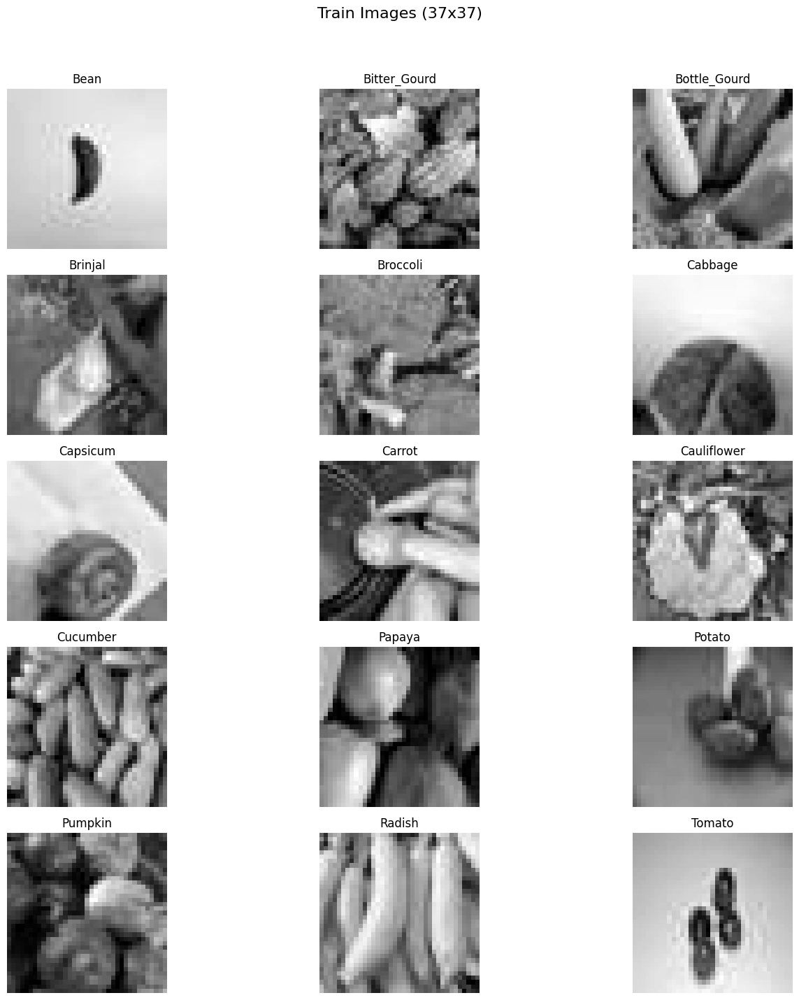

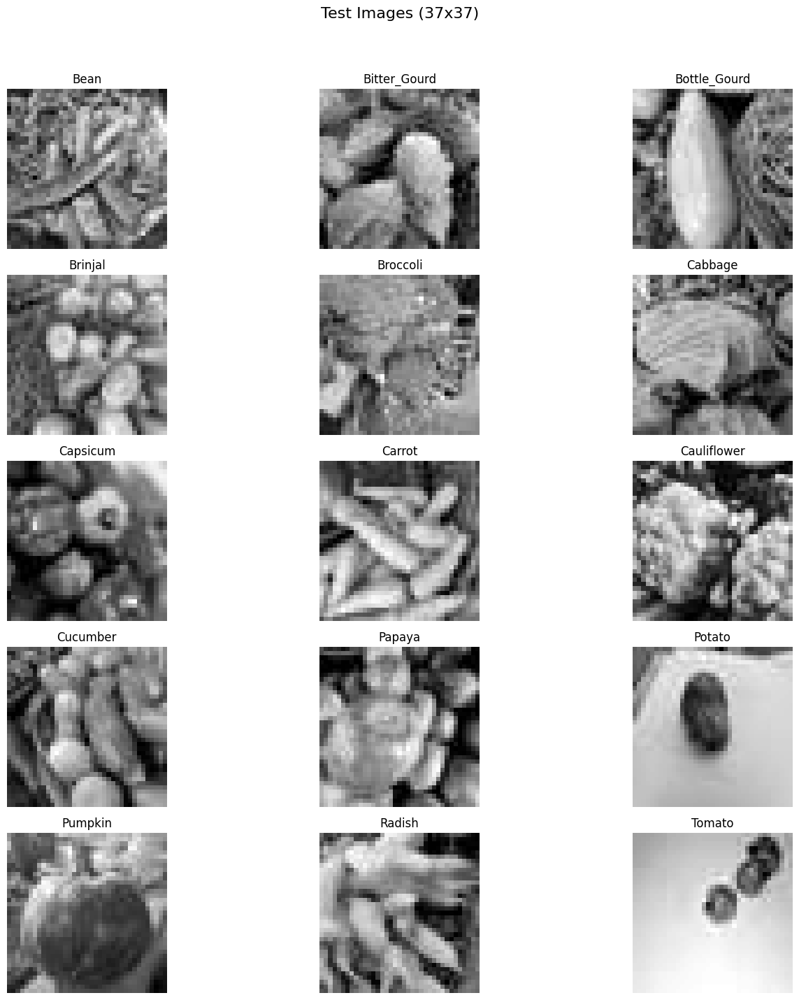

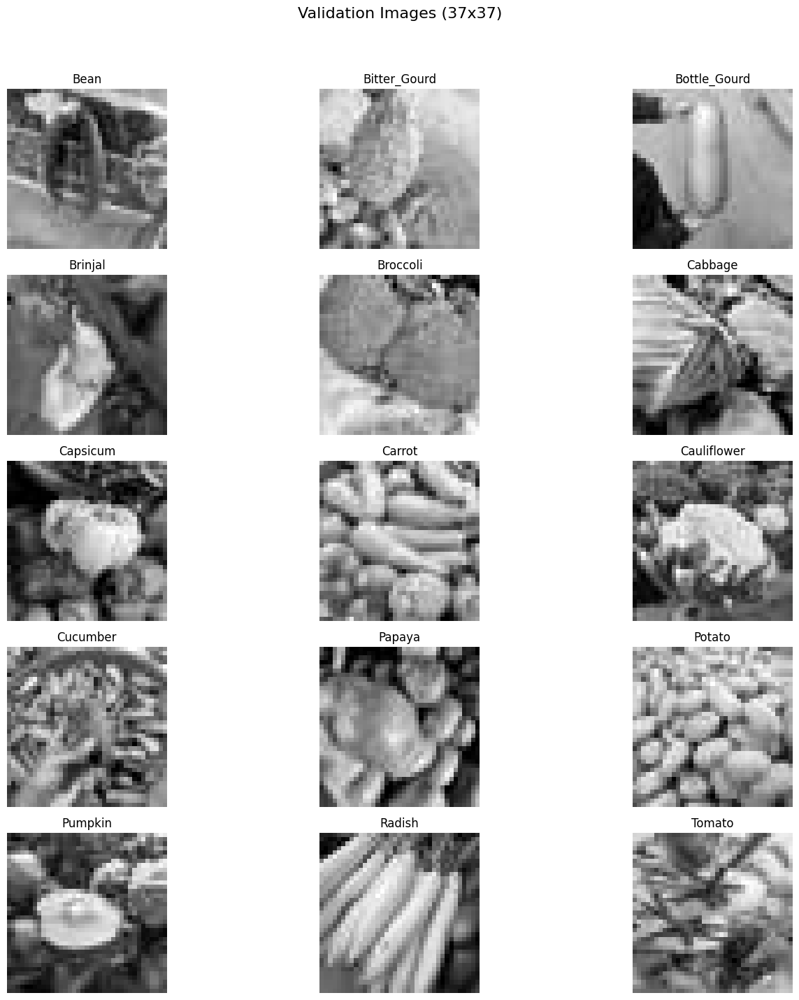

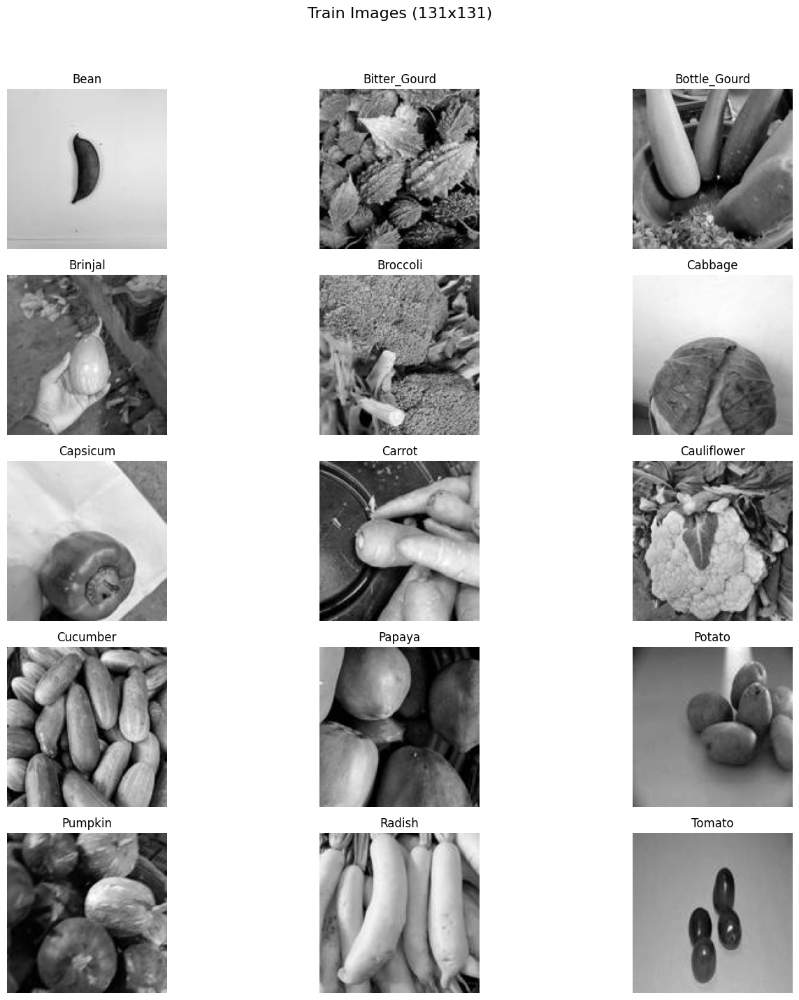

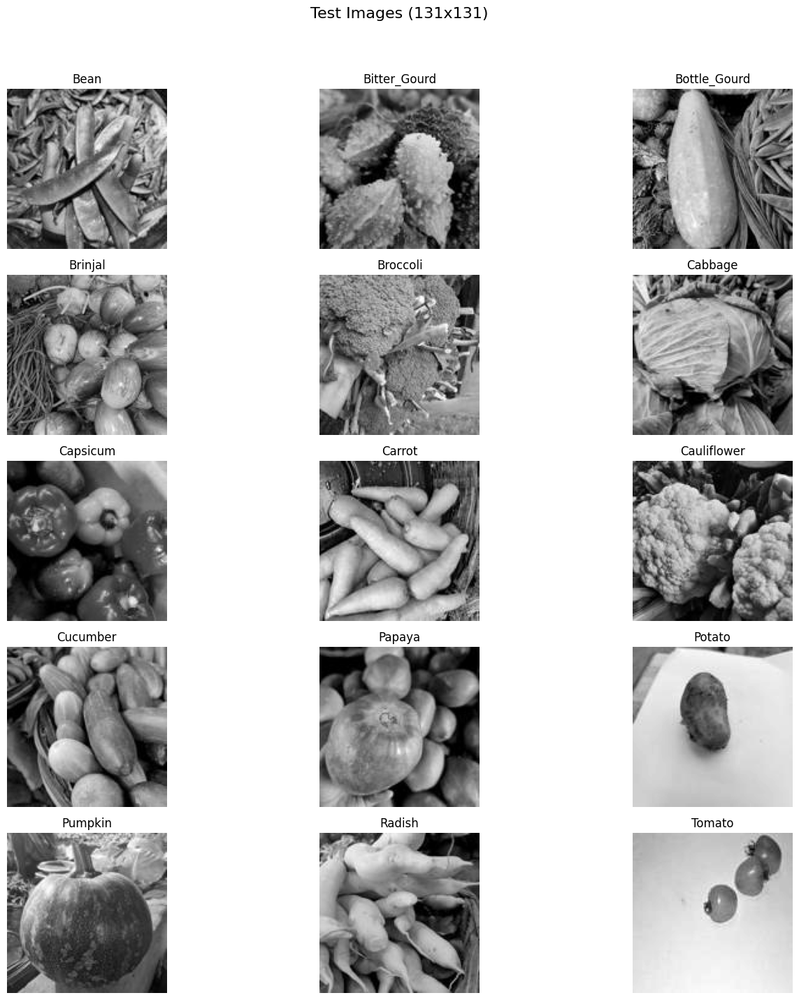

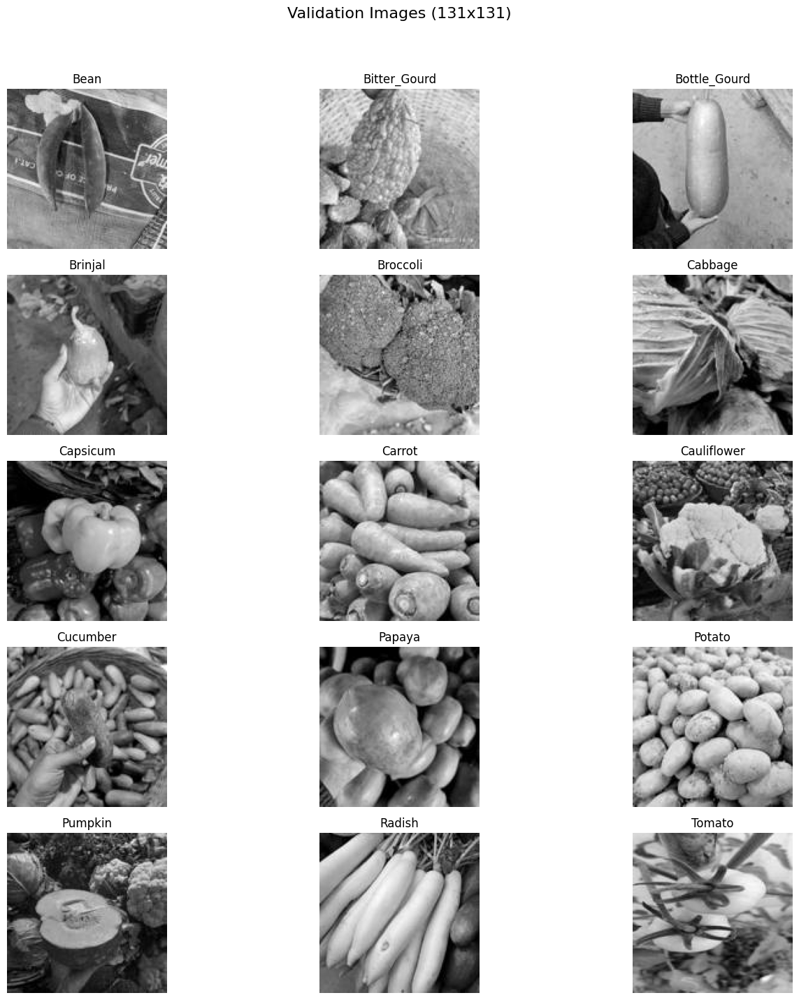

In [13]:
# Define the resized and grayscale directories for train, test, and validation datasets
base_directory = Path('./Cleaned Dataset for CA1 part A - AY2425S1')

resized_grayscale_train_37_dir = base_directory / 'train37'
resized_grayscale_test_37_dir = base_directory / 'test37'
resized_grayscale_validation_37_dir = base_directory / 'validation37'

resized_grayscale_train_131_dir = base_directory / 'train131'
resized_grayscale_test_131_dir = base_directory / 'test131'
resized_grayscale_validation_131_dir = base_directory / 'validation131'

vegetable_types = [
    'Bean', 'Bitter_Gourd', 'Bottle_Gourd', 'Brinjal', 'Broccoli', 'Cabbage',
    'Capsicum', 'Carrot', 'Cauliflower', 'Cucumber', 'Papaya', 'Potato', 
    'Pumpkin', 'Radish', 'Tomato'
]

def plot_vegetable_images(directory, title, image_size):
    fig, axs = plt.subplots(5, 3, figsize=(15, 15))
    fig.suptitle(f'{title} Images ({image_size[0]}x{image_size[1]})', fontsize=16)

    for idx, veg_type in enumerate(vegetable_types):
        image_path = next(directory.glob(f'{veg_type}/*.jpg'), None)  # Get the first image for each vegetable type
        if image_path:
            image = Image.open(str(image_path))
            ax = axs[idx // 3, idx % 3]
            ax.imshow(image, cmap='gray')
            ax.axis('off')  # Hide axes
            ax.set_title(veg_type)

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

# Plot images for each vegetable type in train, test, and validation sets for both image sizes
plot_vegetable_images(resized_grayscale_train_37_dir, 'Train', (37, 37))
plot_vegetable_images(resized_grayscale_test_37_dir, 'Test', (37, 37))
plot_vegetable_images(resized_grayscale_validation_37_dir, 'Validation', (37, 37))

plot_vegetable_images(resized_grayscale_train_131_dir, 'Train', (131, 131))
plot_vegetable_images(resized_grayscale_test_131_dir, 'Test', (131, 131))
plot_vegetable_images(resized_grayscale_validation_131_dir, 'Validation', (131, 131))


#### Raw Data for Baseline Model
---

Cited from: https://www.kaggle.com/code/rejpalcz/datagenerator-for-fast-data-loading

In [4]:
# Set a fixed seed value
seed = 88
tf.random.set_seed(seed)

# Set the paths to the directories where the images are stored
train_directory = './Cleaned Dataset for CA1 part A - AY2425S1/train37'
validation_directory = './Cleaned Dataset for CA1 part A - AY2425S1/validation37'
test_directory = './Cleaned Dataset for CA1 part A - AY2425S1/test37'

# Set up the ImageDataGenerator for training data
train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

# Set up the ImageDataGenerator for validation and test data
datagen = ImageDataGenerator(rescale=1./255)

# Set up the generators to read images from the directories
train37 = train_datagen.flow_from_directory(
    directory=train_directory,
    target_size=(37, 37),
    color_mode='grayscale',
    batch_size=32,
    class_mode='categorical',
    shuffle=True,
    seed=seed
)

val37 = datagen.flow_from_directory(
    directory=validation_directory,
    target_size=(37, 37),
    color_mode='grayscale',
    batch_size=32,
    class_mode='categorical',
    shuffle=False,  
    seed=seed
)

test37 = datagen.flow_from_directory(
    directory=test_directory,
    target_size=(37, 37),
    color_mode='grayscale',
    batch_size=32,
    class_mode='categorical',
    shuffle=False,  
    seed=seed
)


# Set the paths to the directories where the images are stored
train_directory = './Cleaned Dataset for CA1 part A - AY2425S1/train131'
validation_directory = './Cleaned Dataset for CA1 part A - AY2425S1/validation131'
test_directory = './Cleaned Dataset for CA1 part A - AY2425S1/test131'


# Set up the ImageDataGenerator for validation and test data
datagen = ImageDataGenerator(rescale=1./255)

# Set up the generators to read images from the directories
train131 = train_datagen.flow_from_directory(
    directory=train_directory,
    target_size=(131, 131),
    color_mode='grayscale',
    batch_size=32,
    class_mode='categorical',
    shuffle=True,
    seed=seed
)

val131 = datagen.flow_from_directory(
    directory=validation_directory,
    target_size=(131, 131),
    color_mode='grayscale',
    batch_size=32,
    class_mode='categorical',
    shuffle=False,  
    seed=seed
)

test131 = datagen.flow_from_directory(
    directory=test_directory,
    target_size=(131, 131),
    color_mode='grayscale',
    batch_size=32,
    class_mode='categorical',
    shuffle=False,  
    seed=seed
)

Found 9028 images belonging to 15 classes.
Found 3000 images belonging to 15 classes.
Found 3000 images belonging to 15 classes.
Found 9028 images belonging to 15 classes.
Found 3000 images belonging to 15 classes.
Found 3000 images belonging to 15 classes.


In [6]:
# Function to plot confusion matrix
def plot_confusion_matrix(cm, class_names):
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt="d", cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.title('Confusion Matrix')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.show()

#### Weight balancing
---
The purpose of **weight balancing** is to give **more importance (higher weight)** to **minority classes (smaller datasets)**  during model training.

In [5]:
train_label = []
num_batches = 100  
for i, (img, label) in enumerate(train37):
    train_label.extend(tf.argmax(label, axis=1).numpy())
    if i == num_batches:
        break


train_label = np.array(train_label)
class_names = np.unique(train_label)

class_weights37 = compute_class_weight(class_weight='balanced', classes=class_names, y=train_label)
class_weights37 = dict(zip(class_names, class_weights37))
print(class_weights37)

# Cited from: https://scikit-learn.org/stable/modules/generated/sklearn.utils.class_weight.compute_class_weight.html

{0: 0.8584329349269588, 1: 0.8130817610062893, 2: 1.5613526570048308, 3: 0.6609406952965236, 4: 0.795079950799508, 5: 1.1970370370370371, 6: 1.766120218579235, 7: 2.292198581560284, 8: 0.9705705705705706, 9: 0.7182222222222222, 10: 1.0937394247038916, 11: 1.6447837150127227, 12: 0.7328798185941043, 13: 2.2680701754385963, 14: 0.6227360308285164}


In [6]:
train_label = []
num_batches = 100  
for i, (img, label) in enumerate(train131):
    train_label.extend(tf.argmax(label, axis=1).numpy())
    if i == num_batches:
        break


train_label = np.array(train_label)
class_names = np.unique(train_label)

class_weights131 = compute_class_weight(class_weight='balanced', classes=class_names, y=train_label)
class_weights131 = dict(zip(class_names, class_weights131))
print(class_weights131)

{0: 0.8584329349269588, 1: 0.8130817610062893, 2: 1.5613526570048308, 3: 0.6609406952965236, 4: 0.795079950799508, 5: 1.1970370370370371, 6: 1.766120218579235, 7: 2.292198581560284, 8: 0.9705705705705706, 9: 0.7182222222222222, 10: 1.0937394247038916, 11: 1.6447837150127227, 12: 0.7328798185941043, 13: 2.2680701754385963, 14: 0.6227360308285164}


In [7]:
num_classes=15

### **Model Creation**
---
##### **A baseline CNN model serves several important purposes in machine learning and deep learning projects:**

1. **Performance Benchmarking:** Establishes a baseline to compare more complex models and assess improvements.
2. **Understanding Complexity:** Helps determine if a simple or complex model is needed for the problem.
3. **Resource Efficiency:** Baseline models are quicker and require fewer resources, ideal for initial exploration.
4. **Debugging and Testing:** Ensures the infrastructure works correctly before using more complex models.

Cited from: CHATGPT

---
### Baseline Model

---

My Models consists of:
* 1 input conv2D layer
* 1 conv2D layers
* 2 Maxpooling layers
* 1 Flatten layer
* 2 Dense layers
* 1 Dropout layer


Epoch 1/10
283/283 [==============================] - 26s 39ms/step - loss: 2.6126 - accuracy: 0.1350 - val_loss: 2.3127 - val_accuracy: 0.2783
Epoch 2/10
283/283 [==============================] - 7s 23ms/step - loss: 2.3409 - accuracy: 0.2497 - val_loss: 2.0300 - val_accuracy: 0.3720
Epoch 3/10
283/283 [==============================] - 6s 21ms/step - loss: 2.1863 - accuracy: 0.2992 - val_loss: 2.0251 - val_accuracy: 0.3347
Epoch 4/10
283/283 [==============================] - 6s 22ms/step - loss: 2.0465 - accuracy: 0.3309 - val_loss: 1.7381 - val_accuracy: 0.4390
Epoch 5/10
283/283 [==============================] - 6s 22ms/step - loss: 1.9719 - accuracy: 0.3580 - val_loss: 1.6298 - val_accuracy: 0.4783
Epoch 6/10
283/283 [==============================] - 6s 21ms/step - loss: 1.8715 - accuracy: 0.3816 - val_loss: 1.5912 - val_accuracy: 0.4933
Epoch 7/10
283/283 [==============================] - 6s 22ms/step - loss: 1.8168 - accuracy: 0.4047 - val_loss: 1.5375 - val_accuracy: 0.510

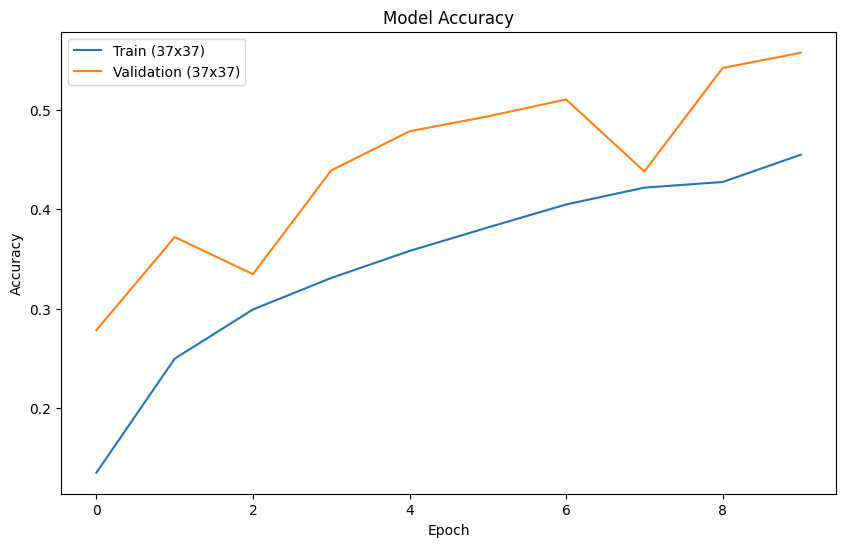

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 35, 35, 32)        320       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 17, 17, 32)       0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 15, 15, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 7, 7, 64)         0         
 2D)                                                             
                                                                 
 flatten (Flatten)           (None, 3136)              0         
                                                                 
 dense (Dense)               (None, 128)               4

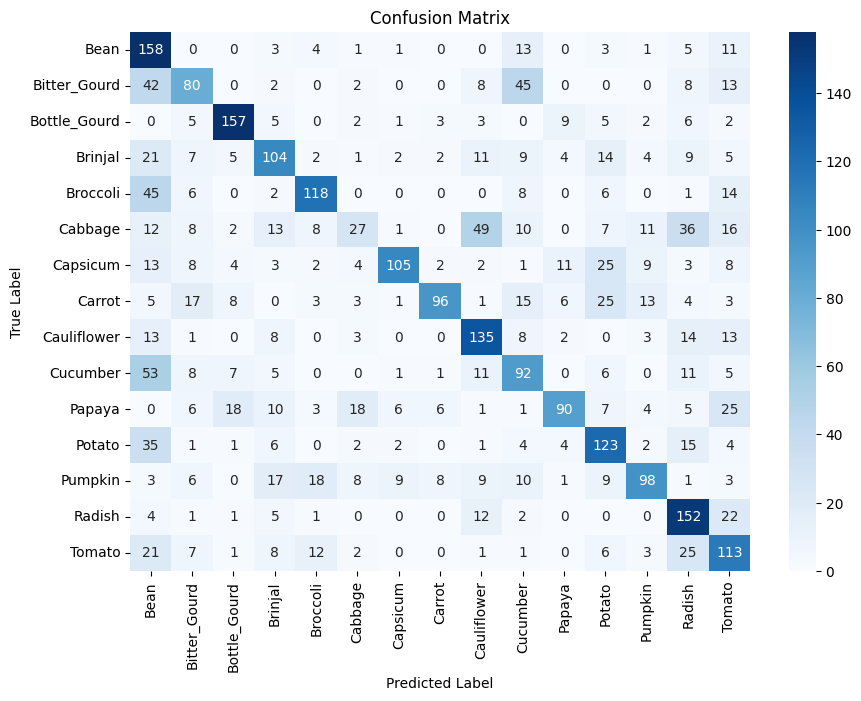

In [19]:
# 37x37 Model

# Define the CNN architecture (LAB3)
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(37, 37, 1)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),  # Dropout layer to reduce overfitting
    Dense(num_classes, activation='softmax')  # Output layer with 15 units for each class
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model using the generators
history = model.fit(
    train37,
    epochs=10,
    validation_data=val37,
    class_weight=class_weights37,
    verbose=1
)

plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (37x37)')
plt.plot(history.history['val_accuracy'], label='Validation (37x37)')

plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

model.summary()

# Predict the output on the test set
predictions = model.predict(test37, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test37.classes

# Get the label to class mapping from the generator
class_labels = list(test37.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)





Epoch 1/10
283/283 [==============================] - 16s 51ms/step - loss: 2.4679 - accuracy: 0.1952 - val_loss: 1.9600 - val_accuracy: 0.3820
Epoch 2/10
283/283 [==============================] - 12s 43ms/step - loss: 1.9952 - accuracy: 0.3642 - val_loss: 1.6420 - val_accuracy: 0.4693
Epoch 3/10
283/283 [==============================] - 12s 43ms/step - loss: 1.7555 - accuracy: 0.4349 - val_loss: 1.2978 - val_accuracy: 0.5983
Epoch 4/10
283/283 [==============================] - 13s 46ms/step - loss: 1.5556 - accuracy: 0.4927 - val_loss: 1.2174 - val_accuracy: 0.6143
Epoch 5/10
283/283 [==============================] - 12s 44ms/step - loss: 1.4077 - accuracy: 0.5411 - val_loss: 1.0436 - val_accuracy: 0.6743
Epoch 6/10
283/283 [==============================] - 12s 44ms/step - loss: 1.2936 - accuracy: 0.5834 - val_loss: 0.9563 - val_accuracy: 0.7007
Epoch 7/10
283/283 [==============================] - 12s 44ms/step - loss: 1.1847 - accuracy: 0.6073 - val_loss: 0.9378 - val_accuracy:

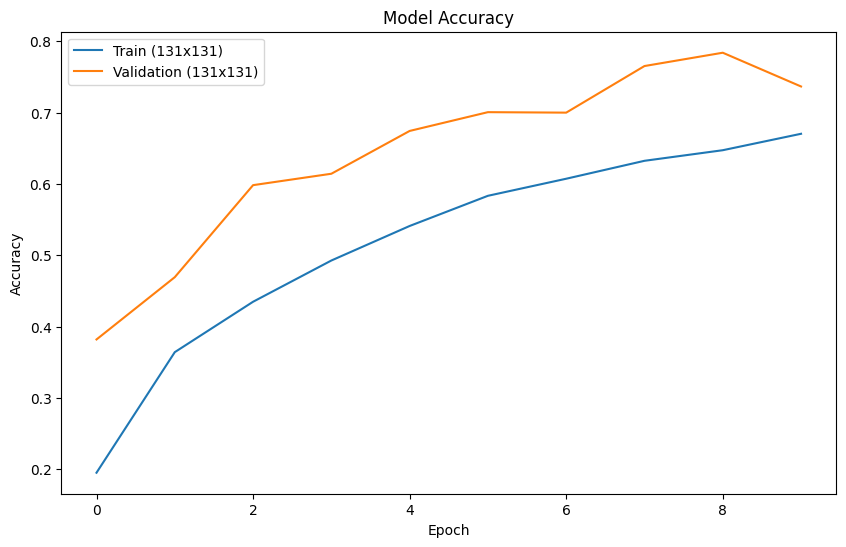

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_2 (Conv2D)           (None, 129, 129, 32)      320       
                                                                 
 max_pooling2d_2 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_3 (Conv2D)           (None, 62, 62, 64)        18496     
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 31, 31, 64)       0         
 2D)                                                             
                                                                 
 flatten_1 (Flatten)         (None, 61504)             0         
                                                                 
 dense_2 (Dense)             (None, 128)              

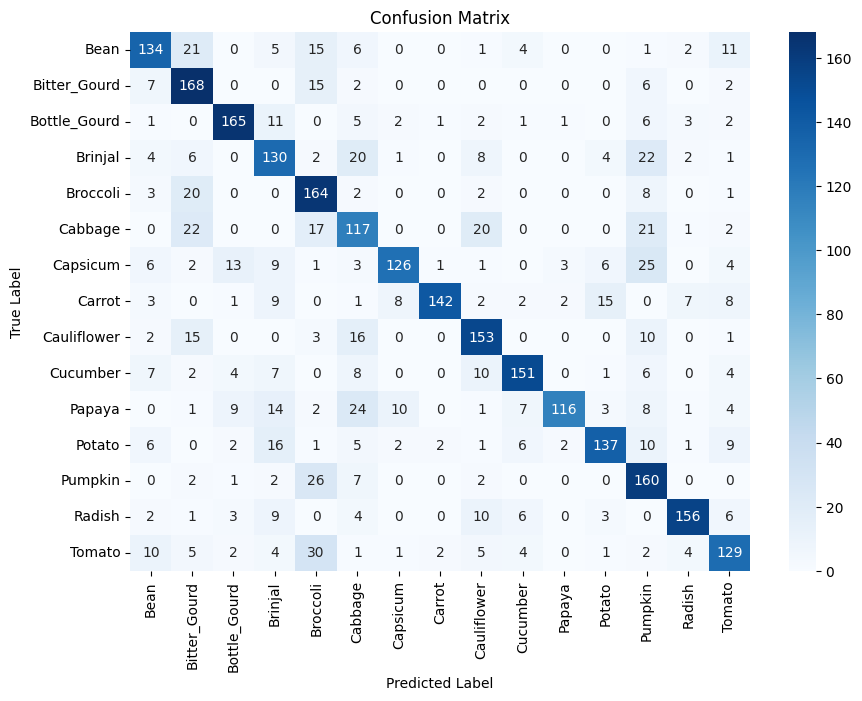

In [20]:
# 131x131 Model

# Define the CNN architecture (LAB3)
model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(131, 131, 1)),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(128, activation='relu'),
    Dropout(0.5),  # Dropout layer to reduce overfitting
    Dense(num_classes, activation='softmax')  # Output layer with 15 units for each class
])

# Compile the model
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Fit the model using the generators
history = model.fit(
    train131,
    epochs=10,
    validation_data=val131,
    class_weight=class_weights131,
    verbose=1
)

plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (131x131)')
plt.plot(history.history['val_accuracy'], label='Validation (131x131)')

plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

model.summary()

# Predict the output on the test set
predictions = model.predict(test131, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test131.classes

# Get the label to class mapping from the generator
class_labels = list(test131.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)





### Model Improvement
---

The Improved Models consists of:
* 1 input conv2D layer
* 2 conv2D layers
* 3 Maxpooling layers
* 3 Dense layers
* 2 Dropout layer
* 1 Flatten layer

and **increasing Epochs from 10 ->100 because**
1. **Better Generalization:** 

        More epochs allow the model to learn from data more thoroughly, identifying patterns and reducing overfitting.
2. **Weight Refinement:** 

        Each epoch refines the model's weights and biases, leading to a more accurate model.
3. **Complex Pattern Learning:** 

        Complex patterns require more epochs for the model to grasp, and longer training helps it learn intricate relationships.
4. **Convergence:** 

        Longer training helps the model converge closer to the best solution, enhancing its performance.

Epoch 1/30
283/283 [==============================] - 7s 22ms/step - loss: 2.6524 - accuracy: 0.1009 - val_loss: 2.4019 - val_accuracy: 0.2367
Epoch 2/30
283/283 [==============================] - 6s 22ms/step - loss: 2.3787 - accuracy: 0.2194 - val_loss: 2.1144 - val_accuracy: 0.3193
Epoch 3/30
283/283 [==============================] - 6s 22ms/step - loss: 2.1736 - accuracy: 0.2891 - val_loss: 1.9762 - val_accuracy: 0.3463
Epoch 4/30
283/283 [==============================] - 6s 21ms/step - loss: 1.9778 - accuracy: 0.3621 - val_loss: 1.6556 - val_accuracy: 0.4743
Epoch 5/30
283/283 [==============================] - 6s 21ms/step - loss: 1.8471 - accuracy: 0.3971 - val_loss: 1.5567 - val_accuracy: 0.4977
Epoch 6/30
283/283 [==============================] - 6s 22ms/step - loss: 1.7285 - accuracy: 0.4375 - val_loss: 1.4388 - val_accuracy: 0.5470
Epoch 7/30
283/283 [==============================] - 6s 21ms/step - loss: 1.6194 - accuracy: 0.4643 - val_loss: 1.4049 - val_accuracy: 0.5667

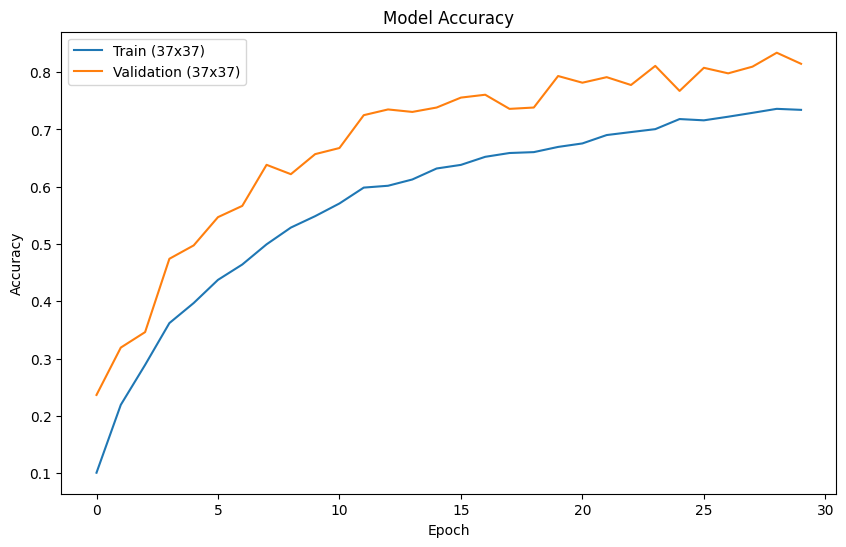

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 33, 33, 64)        1664      
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 16, 16, 64)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 14, 14, 128)       73856     
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 7, 7, 128)        0         
 2D)                                                             
                                                                 
 dropout_2 (Dropout)         (None, 7, 7, 128)         0         
                                                                 
 flatten_2 (Flatten)         (None, 6272)             

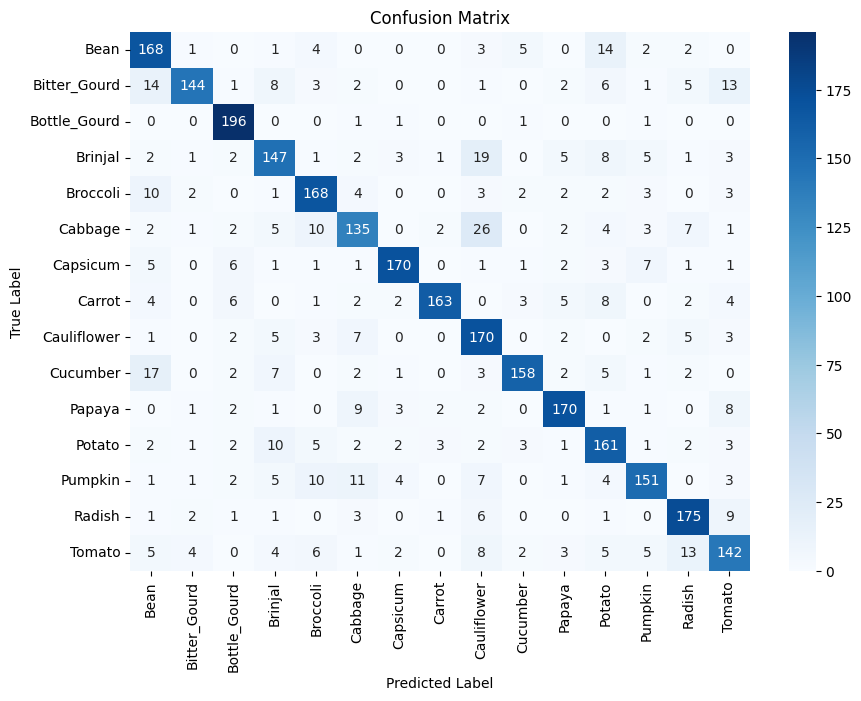

In [21]:
# 37x37 Model

# fix random seed for reproducibility (LAB3)
seed = 88
np.random.seed(seed)

# create model (LAB3)
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(37, 37, 1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Dropout(0.25))
model.add(Flatten())

model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

# Compile model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Fit the model
history_baseline=model.fit(train37, validation_data=(val37), epochs=30, batch_size=200, verbose=1, class_weight=class_weights37)

 # Final evaluation of the model
scores = model.evaluate(test37, verbose=0)
print("CNN Error: %.2f%%" % (100-scores[1]*100))


plt.figure(figsize=(10, 6))
plt.plot(history_baseline.history['accuracy'], label='Train (37x37)')
plt.plot(history_baseline.history['val_accuracy'], label='Validation (37x37)')

plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

model.summary()

# Predict the output on the test set
predictions = model.predict(test37, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test37.classes

# Get the label to class mapping from the generator
class_labels = list(test37.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)

Epoch 1/30
283/283 [==============================] - 23s 73ms/step - loss: 2.5742 - accuracy: 0.1586 - val_loss: 2.1850 - val_accuracy: 0.3103
Epoch 2/30
283/283 [==============================] - 20s 70ms/step - loss: 2.1686 - accuracy: 0.3099 - val_loss: 1.8629 - val_accuracy: 0.4077
Epoch 3/30
283/283 [==============================] - 20s 70ms/step - loss: 1.8989 - accuracy: 0.4065 - val_loss: 1.5450 - val_accuracy: 0.5243
Epoch 4/30
283/283 [==============================] - 20s 70ms/step - loss: 1.6217 - accuracy: 0.4983 - val_loss: 1.4068 - val_accuracy: 0.5487
Epoch 5/30
283/283 [==============================] - 20s 71ms/step - loss: 1.3809 - accuracy: 0.5616 - val_loss: 1.2659 - val_accuracy: 0.5963
Epoch 6/30
283/283 [==============================] - 20s 70ms/step - loss: 1.2266 - accuracy: 0.6079 - val_loss: 0.9230 - val_accuracy: 0.7163
Epoch 7/30
283/283 [==============================] - 20s 71ms/step - loss: 1.0907 - accuracy: 0.6534 - val_loss: 0.8417 - val_accuracy:

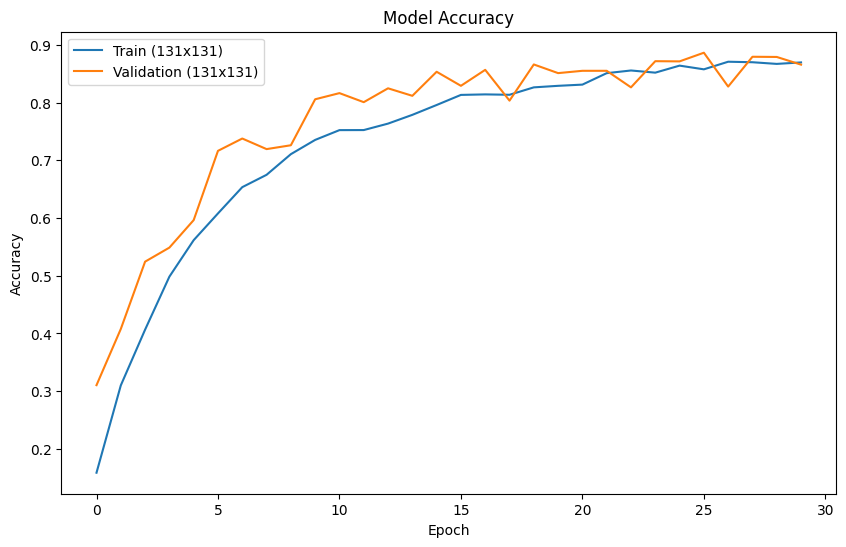

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_6 (Conv2D)           (None, 127, 127, 64)      1664      
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 63, 63, 64)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 61, 61, 128)       73856     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 30, 30, 128)      0         
 2D)                                                             
                                                                 
 dropout_4 (Dropout)         (None, 30, 30, 128)       0         
                                                                 
 flatten_3 (Flatten)         (None, 115200)           

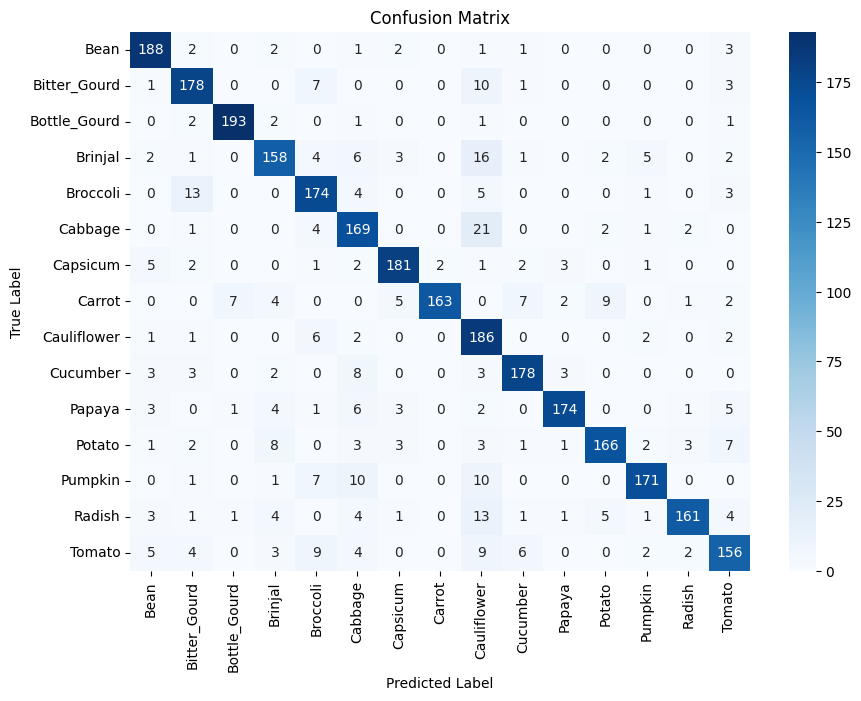

In [22]:
# 131x131 Model

# fix random seed for reproducibility (LAB3)
seed = 88
np.random.seed(seed)

# create model (LAB3)
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(131, 131, 1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Dropout(0.25))
model.add(Flatten())

model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

# Compile model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Fit the model
history_baseline=model.fit(train131, validation_data=(val131), epochs=30, batch_size=200, verbose=1, class_weight=class_weights131)

 # Final evaluation of the model
scores = model.evaluate(test131, verbose=0)
print("CNN Error: %.2f%%" % (100-scores[1]*100))


plt.figure(figsize=(10, 6))
plt.plot(history_baseline.history['accuracy'], label='Train (131x131)')
plt.plot(history_baseline.history['val_accuracy'], label='Validation (131x131)')

plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

model.summary()

# Predict the output on the test set
predictions = model.predict(test131, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test131.classes

# Get the label to class mapping from the generator
class_labels = list(test131.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)

comments on baseline model:



### Increasing Epochs
---
epochs =30 ->100

Epoch 1/100
280/283 [============================>.] - ETA: 0s - loss: 2.6306 - accuracy: 0.1135
Epoch 1: val_accuracy improved from -inf to 0.20067, saving model to ./best_model\100_37x37.h5
283/283 [==============================] - 7s 22ms/step - loss: 2.6304 - accuracy: 0.1142 - val_loss: 2.4502 - val_accuracy: 0.2007
Epoch 2/100
281/283 [============================>.] - ETA: 0s - loss: 2.3637 - accuracy: 0.2450
Epoch 2: val_accuracy improved from 0.20067 to 0.34100, saving model to ./best_model\100_37x37.h5
283/283 [==============================] - 6s 22ms/step - loss: 2.3633 - accuracy: 0.2459 - val_loss: 2.0614 - val_accuracy: 0.3410
Epoch 3/100
280/283 [============================>.] - ETA: 0s - loss: 2.1330 - accuracy: 0.3230
Epoch 3: val_accuracy improved from 0.34100 to 0.39333, saving model to ./best_model\100_37x37.h5
283/283 [==============================] - 6s 22ms/step - loss: 2.1320 - accuracy: 0.3230 - val_loss: 1.9185 - val_accuracy: 0.3933
Epoch 4/100
281/283 [=

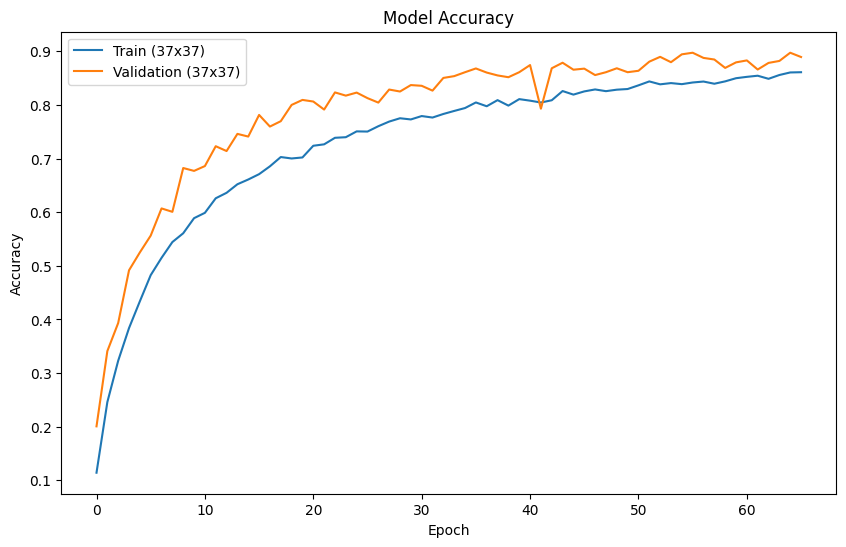

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_33 (Conv2D)          (None, 33, 33, 64)        1664      
                                                                 
 max_pooling2d_33 (MaxPoolin  (None, 16, 16, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_34 (Conv2D)          (None, 14, 14, 128)       73856     
                                                                 
 max_pooling2d_34 (MaxPoolin  (None, 7, 7, 128)        0         
 g2D)                                                            
                                                                 
 dropout_24 (Dropout)        (None, 7, 7, 128)         0         
                                                                 
 flatten_13 (Flatten)        (None, 6272)            

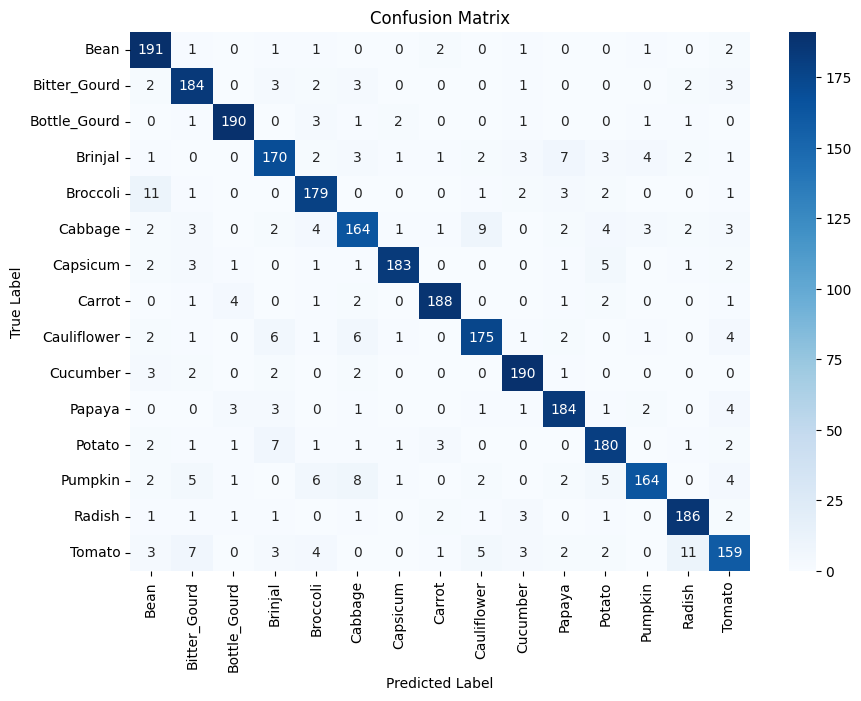

In [33]:
# Fix random seed for reproducibility
seed = 88
np.random.seed(seed)

# Create the model
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(37, 37, 1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Dropout(0.25))
model.add(Flatten())

model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)


# Fit the model with early stopping and model checkpoint
history = model.fit(
    train37, 
    validation_data=val37, 
    epochs=100, 
    batch_size=200, 
    verbose=1, 
    class_weight=class_weights37, 
    callbacks=[early_stopping]
)


# Final evaluation of the model
scores = model.evaluate(test37, verbose=0)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

# Plot accuracy
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (37x37)')
plt.plot(history.history['val_accuracy'], label='Validation (37x37)')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

# Print model summary
model.summary()

# Predict the output on the test set
predictions = model.predict(test37, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test37.classes

# Get the label to class mapping from the generator
class_labels = list(test37.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)


Epoch 1/100
283/283 [==============================] - ETA: 0s - loss: 2.5587 - accuracy: 0.1626
Epoch 1: val_accuracy improved from -inf to 0.30233, saving model to ./best_model\100_131x131.h5
283/283 [==============================] - 22s 76ms/step - loss: 2.5587 - accuracy: 0.1626 - val_loss: 2.1553 - val_accuracy: 0.3023
Epoch 2/100
283/283 [==============================] - ETA: 0s - loss: 2.1517 - accuracy: 0.3090
Epoch 2: val_accuracy improved from 0.30233 to 0.35333, saving model to ./best_model\100_131x131.h5
283/283 [==============================] - 21s 73ms/step - loss: 2.1517 - accuracy: 0.3090 - val_loss: 2.0407 - val_accuracy: 0.3533
Epoch 3/100
283/283 [==============================] - ETA: 0s - loss: 1.8954 - accuracy: 0.3980
Epoch 3: val_accuracy improved from 0.35333 to 0.47400, saving model to ./best_model\100_131x131.h5
283/283 [==============================] - 21s 73ms/step - loss: 1.8954 - accuracy: 0.3980 - val_loss: 1.6601 - val_accuracy: 0.4740
Epoch 4/100
2

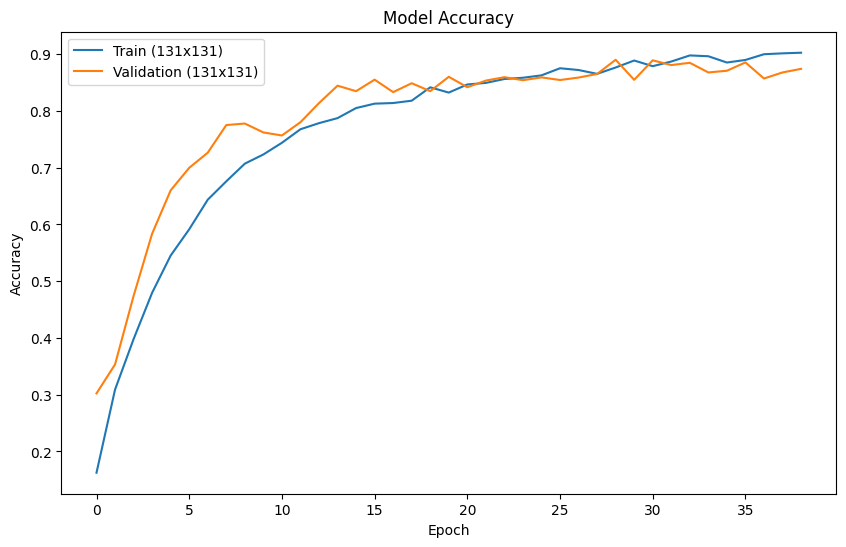

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_35 (Conv2D)          (None, 127, 127, 64)      1664      
                                                                 
 max_pooling2d_35 (MaxPoolin  (None, 63, 63, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_36 (Conv2D)          (None, 61, 61, 128)       73856     
                                                                 
 max_pooling2d_36 (MaxPoolin  (None, 30, 30, 128)      0         
 g2D)                                                            
                                                                 
 dropout_26 (Dropout)        (None, 30, 30, 128)       0         
                                                                 
 flatten_14 (Flatten)        (None, 115200)          

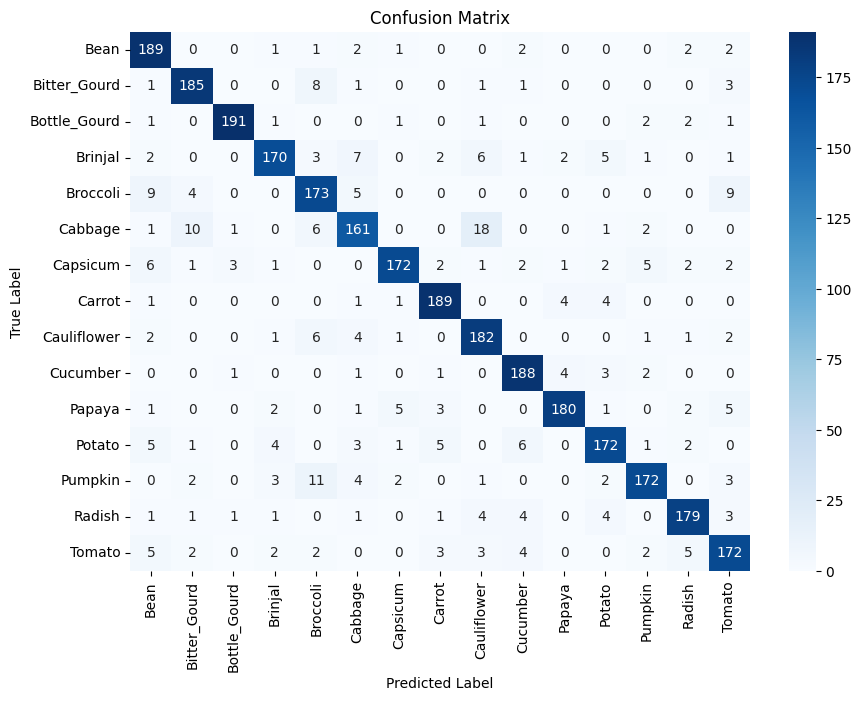

In [34]:
# Fix random seed for reproducibility
seed = 88
np.random.seed(seed)

# Create the model
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(131, 131, 1), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Dropout(0.25))
model.add(Flatten())

model.add(Dense(256, activation='relu'))
model.add(Dropout(0.5))

model.add(Dense(128, activation='relu'))
model.add(Dense(num_classes, activation='softmax'))

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)


# Fit the model with early stopping and model checkpoint
history = model.fit(
    train131, 
    validation_data=val131, 
    epochs=100, 
    batch_size=200, 
    verbose=1, 
    class_weight=class_weights131, 
    callbacks=[early_stopping]
)


# Final evaluation of the model
scores = model.evaluate(test131, verbose=0)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

# Plot accuracy
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (131x131)')
plt.plot(history.history['val_accuracy'], label='Validation (131x131)')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

# Print model summary
model.summary()

# Predict the output on the test set
predictions = model.predict(test131, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test131.classes

# Get the label to class mapping from the generator
class_labels = list(test131.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)


<u><b>Oberservations: </b></u>

I have also realised that the 131x131 model has some underfitting whereby the validation accuracy > train accuracy, hence I would be trying L2 regularisation.


### Reduce underfitting/ overfitting of data for My Model
---

* Adding more Dropout layers
* Adding regularisation L2

**L2 Regularization (Ridge):**

L2 regularization adds a **penalty term proportional to the square of the weights to the loss function.** 

This penalty **discourages large weights** and helps to **smooth out the learned parameters.**

While L2 regularization is more commonly used to address overfitting, 

it can **indirectly prevent underfitting** by ensuring that

the model **doesn't over-rely on a small set of features** or fit the training data too closely.

For text above: Cited from: Chatgpt

For code below, cited from: https://keras.io/api/layers/regularizers/


Epoch 1/100
282/283 [============================>.] - ETA: 0s - loss: 2.6987 - accuracy: 0.0800
Epoch 1: val_accuracy improved from -inf to 0.13500, saving model to ./best_model\100_37x37.h5
283/283 [==============================] - 11s 36ms/step - loss: 2.6974 - accuracy: 0.0806 - val_loss: 2.5704 - val_accuracy: 0.1350
Epoch 2/100
282/283 [============================>.] - ETA: 0s - loss: 2.5356 - accuracy: 0.1608
Epoch 2: val_accuracy improved from 0.13500 to 0.22433, saving model to ./best_model\100_37x37.h5
283/283 [==============================] - 6s 22ms/step - loss: 2.5357 - accuracy: 0.1607 - val_loss: 2.3789 - val_accuracy: 0.2243
Epoch 3/100
281/283 [============================>.] - ETA: 0s - loss: 2.3736 - accuracy: 0.2163
Epoch 3: val_accuracy improved from 0.22433 to 0.30033, saving model to ./best_model\100_37x37.h5
283/283 [==============================] - 6s 23ms/step - loss: 2.3736 - accuracy: 0.2167 - val_loss: 2.1937 - val_accuracy: 0.3003
Epoch 4/100
281/283 [

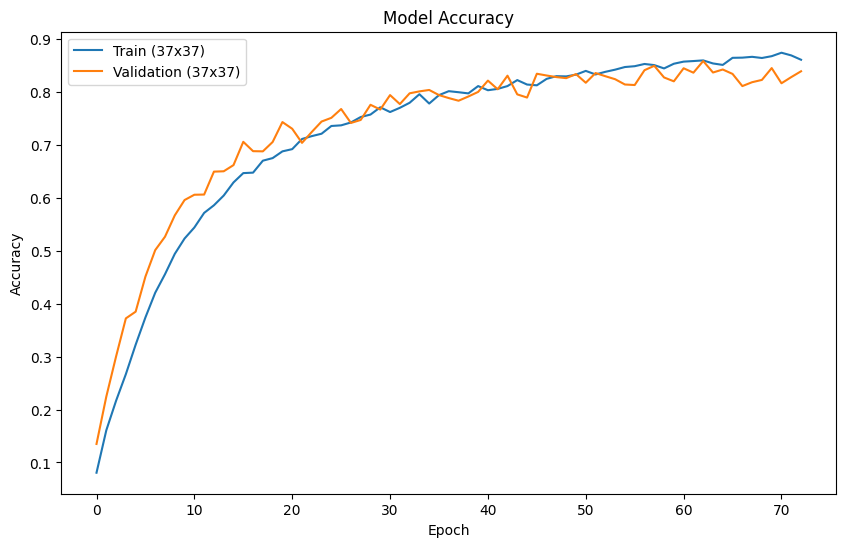

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_37 (Conv2D)          (None, 33, 33, 64)        1664      
                                                                 
 max_pooling2d_37 (MaxPoolin  (None, 16, 16, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_38 (Conv2D)          (None, 14, 14, 128)       73856     
                                                                 
 max_pooling2d_38 (MaxPoolin  (None, 7, 7, 128)        0         
 g2D)                                                            
                                                                 
 conv2d_39 (Conv2D)          (None, 5, 5, 128)         147584    
                                                                 
 max_pooling2d_39 (MaxPoolin  (None, 2, 2, 128)      

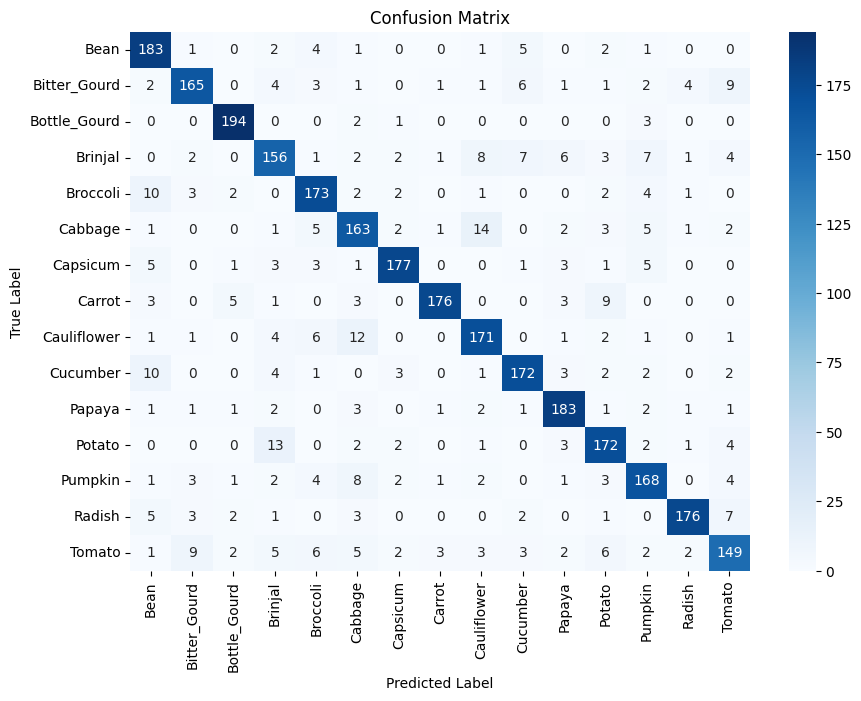

In [35]:
# fix random seed for reproducibility
seed = 88
np.random.seed(seed)

# create model
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(37, 37, 1), activation='relu',kernel_regularizer=l2(0.0001)))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())

model.add(Dense(256, activation='relu',kernel_regularizer=l2(0.0001)))
model.add(Dropout(0.25))

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.25))

model.add(Dense(num_classes, activation='softmax'))

# Compile model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)

# Fit the model with early stopping and model checkpoint
history = model.fit(
    train37, 
    validation_data=val37, 
    epochs=100, 
    batch_size=200, 
    verbose=1, 
    class_weight=class_weights37, 
    callbacks=[early_stopping]
)



# Final evaluation of the model
scores = model.evaluate(test37, verbose=0)
print("CNN Error: %.2f%%" % (100-scores[1]*100))

plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (37x37)')
plt.plot(history.history['val_accuracy'], label='Validation (37x37)')

plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

model.summary()

# Predict the output on the test set
predictions = model.predict(test37, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test37.classes

# Get the label to class mapping from the generator
class_labels = list(test37.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)

Epoch 1/100
283/283 [==============================] - ETA: 0s - loss: 2.6323 - accuracy: 0.1173
Epoch 1: val_accuracy improved from -inf to 0.19900, saving model to ./best_model\100_131x131.h5
283/283 [==============================] - 21s 71ms/step - loss: 2.6323 - accuracy: 0.1173 - val_loss: 2.3674 - val_accuracy: 0.1990
Epoch 2/100
283/283 [==============================] - ETA: 0s - loss: 2.3528 - accuracy: 0.2153
Epoch 2: val_accuracy improved from 0.19900 to 0.31067, saving model to ./best_model\100_131x131.h5
283/283 [==============================] - 20s 70ms/step - loss: 2.3528 - accuracy: 0.2153 - val_loss: 2.1335 - val_accuracy: 0.3107
Epoch 3/100
283/283 [==============================] - ETA: 0s - loss: 1.9582 - accuracy: 0.3790
Epoch 3: val_accuracy improved from 0.31067 to 0.46333, saving model to ./best_model\100_131x131.h5
283/283 [==============================] - 20s 71ms/step - loss: 1.9582 - accuracy: 0.3790 - val_loss: 1.7167 - val_accuracy: 0.4633
Epoch 4/100
2

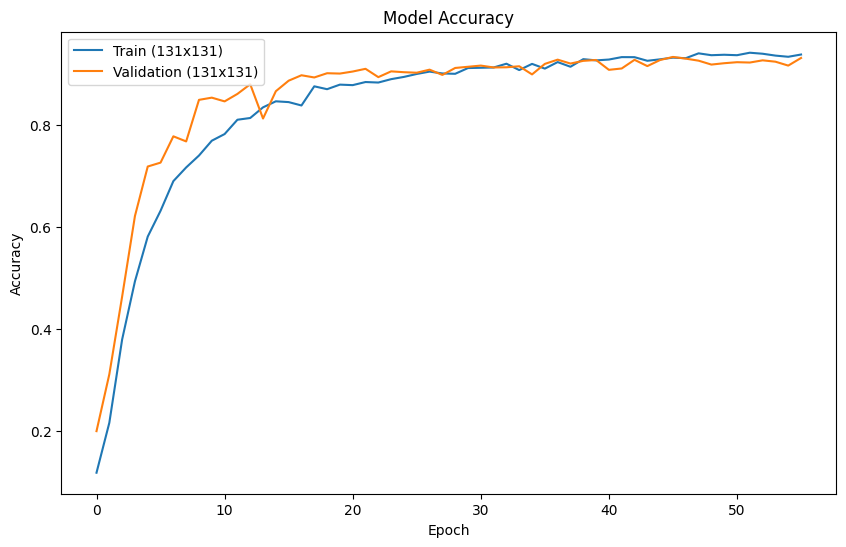

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_40 (Conv2D)          (None, 127, 127, 64)      1664      
                                                                 
 max_pooling2d_40 (MaxPoolin  (None, 63, 63, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_41 (Conv2D)          (None, 61, 61, 128)       73856     
                                                                 
 max_pooling2d_41 (MaxPoolin  (None, 30, 30, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_42 (Conv2D)          (None, 28, 28, 128)       147584    
                                                                 
 max_pooling2d_42 (MaxPoolin  (None, 14, 14, 128)    

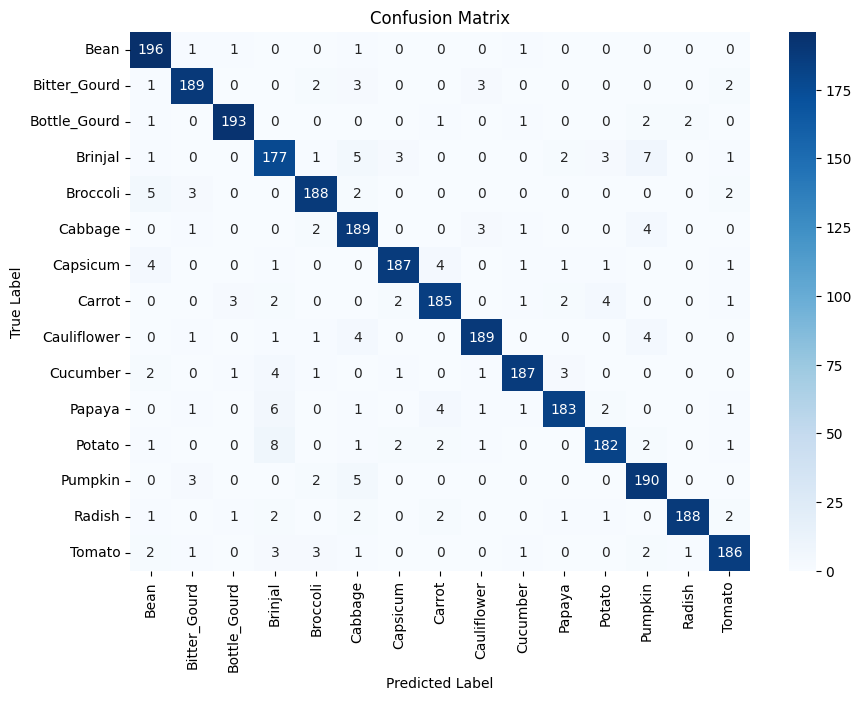

In [36]:
# fix random seed for reproducibility
seed = 88
np.random.seed(seed)

# create model
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(131, 131, 1), activation='relu',kernel_regularizer=l2(0.0001)))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())

model.add(Dense(256, activation='relu',kernel_regularizer=l2(0.0001)))
model.add(Dropout(0.25))

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.25))

model.add(Dense(num_classes, activation='softmax'))

# Compile model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)

# Fit the model with early stopping and model checkpoint
history = model.fit(
    train131, 
    validation_data=val131, 
    epochs=100, 
    batch_size=200, 
    verbose=1, 
    class_weight=class_weights131, 
    callbacks=[early_stopping]
)


# Final evaluation of the model
scores = model.evaluate(test131, verbose=0)
print("CNN Error: %.2f%%" % (100-scores[1]*100))

plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (131x131)')
plt.plot(history.history['val_accuracy'], label='Validation (131x131)')

plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

model.summary()

# Predict the output on the test set
predictions = model.predict(test131, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test131.classes

# Get the label to class mapping from the generator
class_labels = list(test131.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)

Increasing Epochs from 100 to 200

Epoch 1/200
282/283 [============================>.] - ETA: 0s - loss: 2.7215 - accuracy: 0.0630
Epoch 1: val_accuracy improved from -inf to 0.13533, saving model to ./best_model\200_37x37.h5
283/283 [==============================] - 11s 37ms/step - loss: 2.7215 - accuracy: 0.0629 - val_loss: 2.6469 - val_accuracy: 0.1353
Epoch 2/200
282/283 [============================>.] - ETA: 0s - loss: 2.5652 - accuracy: 0.1491
Epoch 2: val_accuracy improved from 0.13533 to 0.22600, saving model to ./best_model\200_37x37.h5
283/283 [==============================] - 6s 22ms/step - loss: 2.5649 - accuracy: 0.1492 - val_loss: 2.3680 - val_accuracy: 0.2260
Epoch 3/200
283/283 [==============================] - ETA: 0s - loss: 2.3739 - accuracy: 0.2315
Epoch 3: val_accuracy improved from 0.22600 to 0.26700, saving model to ./best_model\200_37x37.h5
283/283 [==============================] - 6s 23ms/step - loss: 2.3739 - accuracy: 0.2315 - val_loss: 2.2274 - val_accuracy: 0.2670
Epoch 4/200
281/283 [

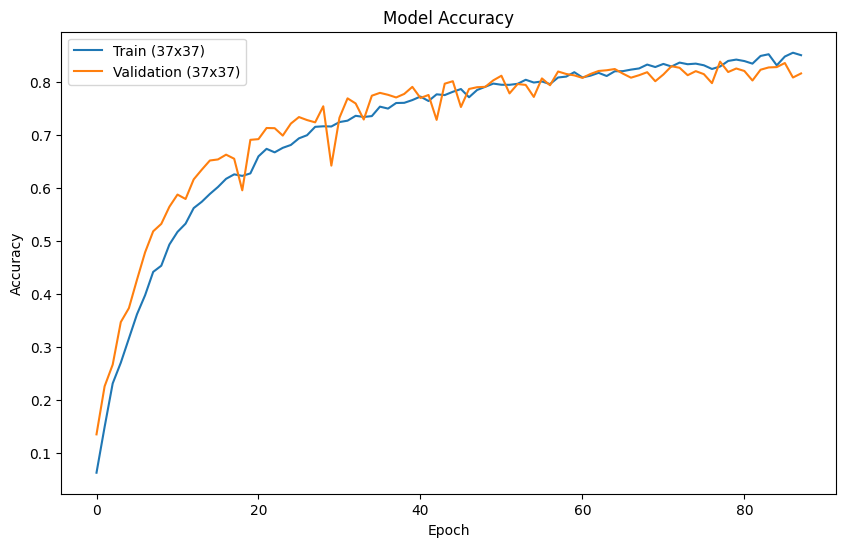

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_43 (Conv2D)          (None, 33, 33, 64)        1664      
                                                                 
 max_pooling2d_43 (MaxPoolin  (None, 16, 16, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_44 (Conv2D)          (None, 14, 14, 128)       73856     
                                                                 
 max_pooling2d_44 (MaxPoolin  (None, 7, 7, 128)        0         
 g2D)                                                            
                                                                 
 conv2d_45 (Conv2D)          (None, 5, 5, 128)         147584    
                                                                 
 max_pooling2d_45 (MaxPoolin  (None, 2, 2, 128)      

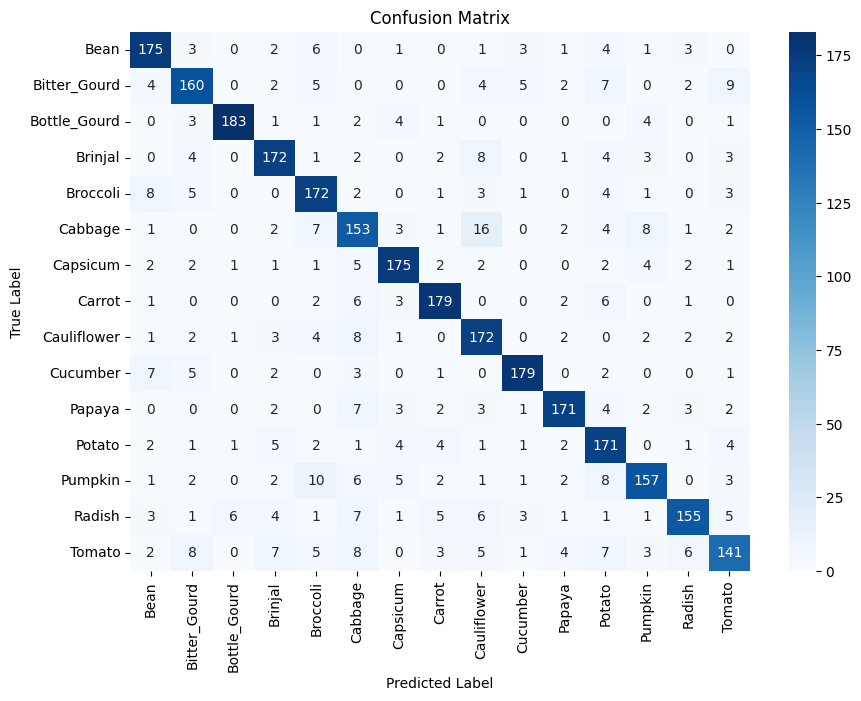

In [37]:
# Fix random seed for reproducibility
seed = 88
np.random.seed(seed)

# Create the model
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(37, 37, 1), activation='relu', kernel_regularizer=l2(0.0001)))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())

model.add(Dense(256, activation='relu', kernel_regularizer=l2(0.0001)))
model.add(Dropout(0.25))

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.25))

model.add(Dense(num_classes, activation='softmax'))

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])


# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)

# Fit the model with early stopping and model checkpoint
history = model.fit(
    train37, 
    validation_data=val37, 
    epochs=200, 
    batch_size=200, 
    verbose=1, 
    class_weight=class_weights37, 
    callbacks=[early_stopping]
)


# Evaluate the best model on the test set
scores = model.evaluate(test37, verbose=0)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

# Plot accuracy
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (37x37)')
plt.plot(history.history['val_accuracy'], label='Validation (37x37)')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

# Print model summary
model.summary()

# Predict the output on the test set using the best model
predictions = model.predict(test37, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test37.classes

# Get the label to class mapping from the generator
class_labels = list(test37.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)


Epoch 1/200
283/283 [==============================] - ETA: 0s - loss: 2.6393 - accuracy: 0.1283
Epoch 1: val_accuracy improved from -inf to 0.24267, saving model to ./best_model\200_131x131.h5
283/283 [==============================] - 21s 71ms/step - loss: 2.6393 - accuracy: 0.1283 - val_loss: 2.3195 - val_accuracy: 0.2427
Epoch 2/200
283/283 [==============================] - ETA: 0s - loss: 2.2386 - accuracy: 0.2735
Epoch 2: val_accuracy improved from 0.24267 to 0.38833, saving model to ./best_model\200_131x131.h5
283/283 [==============================] - 20s 71ms/step - loss: 2.2386 - accuracy: 0.2735 - val_loss: 1.8972 - val_accuracy: 0.3883
Epoch 3/200
283/283 [==============================] - ETA: 0s - loss: 1.9462 - accuracy: 0.3862
Epoch 3: val_accuracy improved from 0.38833 to 0.48600, saving model to ./best_model\200_131x131.h5
283/283 [==============================] - 20s 71ms/step - loss: 1.9462 - accuracy: 0.3862 - val_loss: 1.6529 - val_accuracy: 0.4860
Epoch 4/200
2

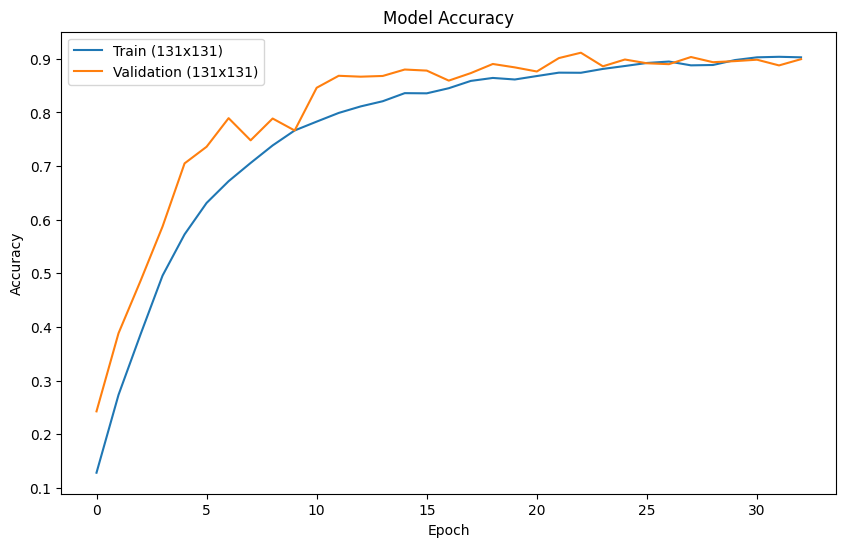

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_46 (Conv2D)          (None, 127, 127, 64)      1664      
                                                                 
 max_pooling2d_46 (MaxPoolin  (None, 63, 63, 64)       0         
 g2D)                                                            
                                                                 
 conv2d_47 (Conv2D)          (None, 61, 61, 128)       73856     
                                                                 
 max_pooling2d_47 (MaxPoolin  (None, 30, 30, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_48 (Conv2D)          (None, 28, 28, 128)       147584    
                                                                 
 max_pooling2d_48 (MaxPoolin  (None, 14, 14, 128)    

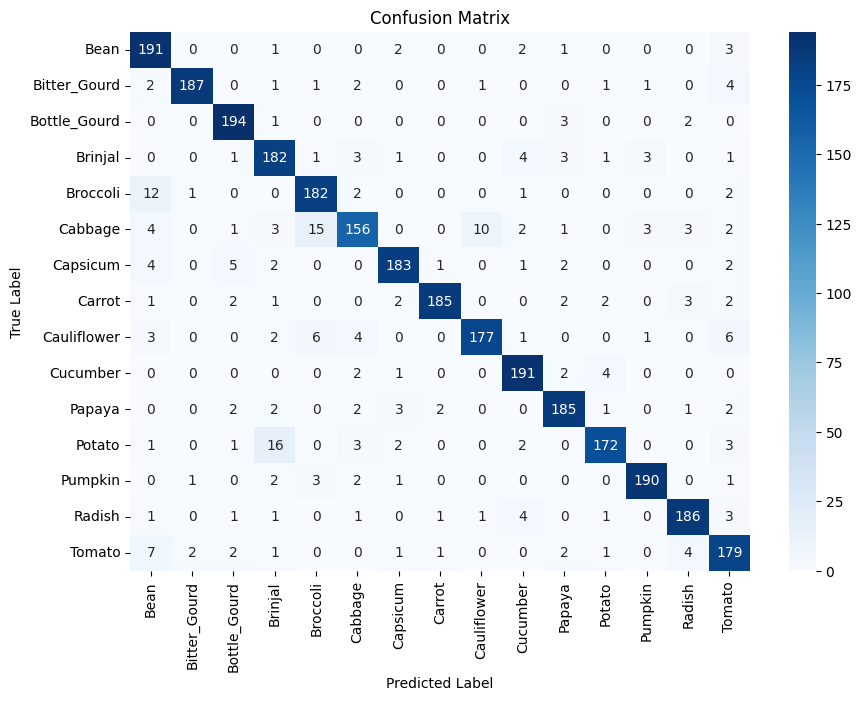

In [38]:
# Fix random seed for reproducibility
seed = 88
np.random.seed(seed)

# Create the model
model = Sequential()

model.add(Conv2D(64, (5, 5), input_shape=(131, 131, 1), activation='relu', kernel_regularizer=l2(0.0001)))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Conv2D(128, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))

model.add(Flatten())

model.add(Dense(256, activation='relu', kernel_regularizer=l2(0.0001)))
model.add(Dropout(0.25))

model.add(Dense(128, activation='relu'))
model.add(Dropout(0.25))

model.add(Dense(num_classes, activation='softmax'))

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])


# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)


# Fit the model with early stopping and model checkpoint
history = model.fit(
    train131, 
    validation_data=val131, 
    epochs=200, 
    batch_size=200, 
    verbose=1, 
    class_weight=class_weights131, 
    callbacks=[early_stopping]
)


# Evaluate the best model on the test set
scores = model.evaluate(test131, verbose=0)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

# Plot accuracy
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (131x131)')
plt.plot(history.history['val_accuracy'], label='Validation (131x131)')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

# Print model summary
model.summary()

# Predict the output on the test set using the best model
predictions = model.predict(test131, verbose=1)
predicted_classes = np.argmax(predictions, axis=1)

# Get the true labels
true_classes = test131.classes

# Get the label to class mapping from the generator
class_labels = list(test131.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

plot_confusion_matrix(cm, class_labels)

<u><b>Observations:</b></u>



The **validation accuracy** from 100 epochs to 200 epochs have dropped and it may due to 

**Model Complexity**: 

If the model is **too complex or has too many parameters relative to the size of the dataset**, 

training for longer may worsen overfitting rather than improving generalization.

Hence, I would be using the **improved model with L2 regularisation with 100 epochs**

### **Hyperparameter Tuning using RandomSearch**
---

RandomizedSearchCV **helps find the best combination of hyperparameters** for a model. 

It **automates the process of tuning hyperparameters**, which affect how the model learns. 

Here's how it helps:

* **Efficient Search:** 

Instead of manually trying different settings, RandomizedSearchCV randomly tries combinations in a defined range. 

This saves time and computer power compared to testing every possibility.

* **Better Settings:** 

By trying out many combinations, it finds the ones that make the model perform best. This can improve how accurate, adaptable, and stable the model is.

* **Avoiding Overfitting:** 

It helps find settings that make the model work well with new data, preventing it from becoming too focused on the training data and losing accuracy.

* **Works with Cross-Validation:** 

RandomizedSearchCV can be used with methods like k-fold cross-validation to test settings across different parts of the training data.

In [12]:
# Set the seed for reproducibility
seed = 88
np.random.seed(seed)
tf.random.set_seed(seed)


# Define a function to create the Keras model with hyperparameters
def build_model(hp):
    model = Sequential([
    Conv2D(hp.Int('filters_1', 64, 256, step=64), (5, 5), input_shape=(37, 37, 1), activation='relu', kernel_regularizer=l2(0.0001)),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(hp.Int('filters_2', 64, 256, step=64), (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(hp.Int('filters_3', 64, 256, step=64), (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(hp.Int('dense_units1', 128, 256, step=64), activation='relu', kernel_regularizer=l2(0.0001)),
    Dropout(0.25),
    Dense(hp.Int('dense_units2', 128, 256, step=64), activation='relu'),
    Dropout(0.25),
    Dense(15, activation='softmax')
    ])
    
    model.compile(optimizer=hp.Choice('optimizer', ['adam', 'rmsprop']),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
    return model

# Initialize the Keras Tuner
tuner = RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=10,
    executions_per_trial=1,
    directory='keras_tuner_results37',
    project_name='vegetable_classification'
)

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)

# Perform hyperparameter tuning
tuner.search(train37, epochs=100, validation_data=val37, callbacks=[early_stopping])

# Retrieve the best model
best_model = tuner.get_best_models(num_models=1)[0]
best_model.save('./best_model/best_37x37_model.h5')

# Retrieve the best hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print the best hyperparameters
print("Best Hyperparameters:")
print(f"filters_1: {best_hyperparameters.get('filters_1')}")
print(f"filters_2: {best_hyperparameters.get('filters_2')}")
print(f"filters_3: {best_hyperparameters.get('filters_3')}")
print(f"dense_units1: {best_hyperparameters.get('dense_units1')}")
print(f"dense_units2: {best_hyperparameters.get('dense_units2')}")
print(f"optimizer: {best_hyperparameters.get('optimizer')}")
# Got some help/adapted from: https://keras.io/guides/keras_tuner/getting_started/

# Evaluate the best model
test_accuracy = best_model.evaluate(test37, verbose=1)
print("Test Accuracy:", test_accuracy)

# Print the CNN error
scores = best_model.evaluate(test37, verbose=0)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

Reloading Tuner from keras_tuner_results37\vegetable_classification\tuner0.json


Best Hyperparameters:
filters_1: 64
filters_2: 256
filters_3: 64
dense_units1: 192
dense_units2: 192
optimizer: adam
94/94 [==============================] - 2s 14ms/step - loss: 0.5026 - accuracy: 0.8753
Test Accuracy: [0.5026257634162903, 0.875333309173584]
CNN Error: 12.47%


In [13]:

# Set the seed for reproducibility
seed = 88
np.random.seed(seed)
tf.random.set_seed(seed)




# Define a function to create the Keras model with hyperparameters
def build_model(hp):
    model = Sequential([
    Conv2D(hp.Int('filters_1', 64, 256, step=64), (5, 5), input_shape=(131, 131, 1), activation='relu', kernel_regularizer=l2(0.0001)),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(hp.Int('filters_2', 64, 256, step=64), (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(hp.Int('filters_3', 64, 256, step=64), (3, 3), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(hp.Int('dense_units1', 128, 256, step=64), activation='relu', kernel_regularizer=l2(0.0001)),
    Dropout(0.25),
    Dense(hp.Int('dense_units2', 128, 256, step=64), activation='relu'),
    Dropout(0.25),
    Dense(15, activation='softmax')
    ])
    
    model.compile(optimizer=hp.Choice('optimizer', ['adam', 'rmsprop']),
                  loss='categorical_crossentropy',
                  metrics=['accuracy'])
    return model

# Initialize the Keras Tuner
tuner = RandomSearch(
    build_model,
    objective='val_accuracy',
    max_trials=8,
    executions_per_trial=1,
    directory='keras_tuner_results131',
    project_name='vegetable_classification'
)

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=10, restore_best_weights=True, verbose=1)

# Perform hyperparameter tuning
tuner.search(train131, epochs=100, validation_data=val131, callbacks=[early_stopping])

# Retrieve the best model
best_model = tuner.get_best_models(num_models=1)[0]
best_model.save('./best_model/best_131x131_model.h5')

# Retrieve the best hyperparameters
best_hyperparameters = tuner.get_best_hyperparameters(num_trials=1)[0]

# Print the best hyperparameters
print("Best Hyperparameters:")
print(f"filters_1: {best_hyperparameters.get('filters_1')}")
print(f"filters_2: {best_hyperparameters.get('filters_2')}")
print(f"filters_3: {best_hyperparameters.get('filters_3')}")
print(f"dense_units1: {best_hyperparameters.get('dense_units1')}")
print(f"dense_units2: {best_hyperparameters.get('dense_units2')}")
print(f"optimizer: {best_hyperparameters.get('optimizer')}")


# Evaluate the best model
test_accuracy = best_model.evaluate(test131, verbose=1)
print("Test Accuracy:", test_accuracy)

# Print the CNN error
scores = best_model.evaluate(test131, verbose=0)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

Reloading Tuner from keras_tuner_results131\vegetable_classification\tuner0.json


Best Hyperparameters:
filters_1: 64
filters_2: 256
filters_3: 256
dense_units1: 256
dense_units2: 128
optimizer: adam
94/94 [==============================] - 3s 23ms/step - loss: 0.4304 - accuracy: 0.9410
Test Accuracy: [0.43037083745002747, 0.9409999847412109]
CNN Error: 5.90%


### Saving Best Models with Hyperparameter Tuning
---

Epoch 1/100
283/283 [==============================] - 11s 36ms/step - loss: 0.3102 - accuracy: 0.9136 - val_loss: 0.6833 - val_accuracy: 0.8530
Epoch 2/100
283/283 [==============================] - 6s 21ms/step - loss: 0.2935 - accuracy: 0.9193 - val_loss: 0.6311 - val_accuracy: 0.8507
Epoch 3/100
283/283 [==============================] - 6s 21ms/step - loss: 0.2960 - accuracy: 0.9186 - val_loss: 0.6795 - val_accuracy: 0.8470
Epoch 4/100
283/283 [==============================] - 6s 22ms/step - loss: 0.3183 - accuracy: 0.9129 - val_loss: 0.5888 - val_accuracy: 0.8627
Epoch 5/100
283/283 [==============================] - 6s 21ms/step - loss: 0.3140 - accuracy: 0.9083 - val_loss: 0.6610 - val_accuracy: 0.8467
Epoch 6/100
283/283 [==============================] - 6s 22ms/step - loss: 0.2892 - accuracy: 0.9135 - val_loss: 0.6380 - val_accuracy: 0.8557
Epoch 7/100
283/283 [==============================] - 6s 21ms/step - loss: 0.2840 - accuracy: 0.9201 - val_loss: 0.6817 - val_accuracy

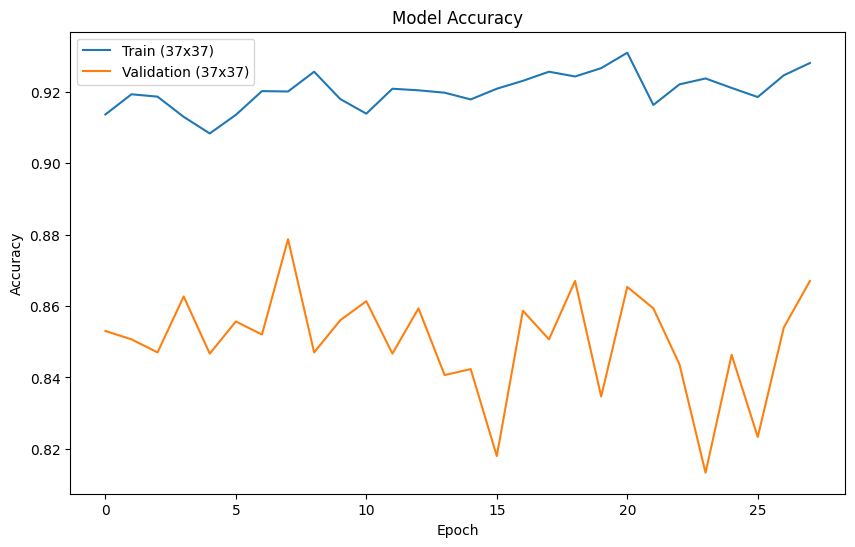

94/94 [==============================] - 1s 12ms/step


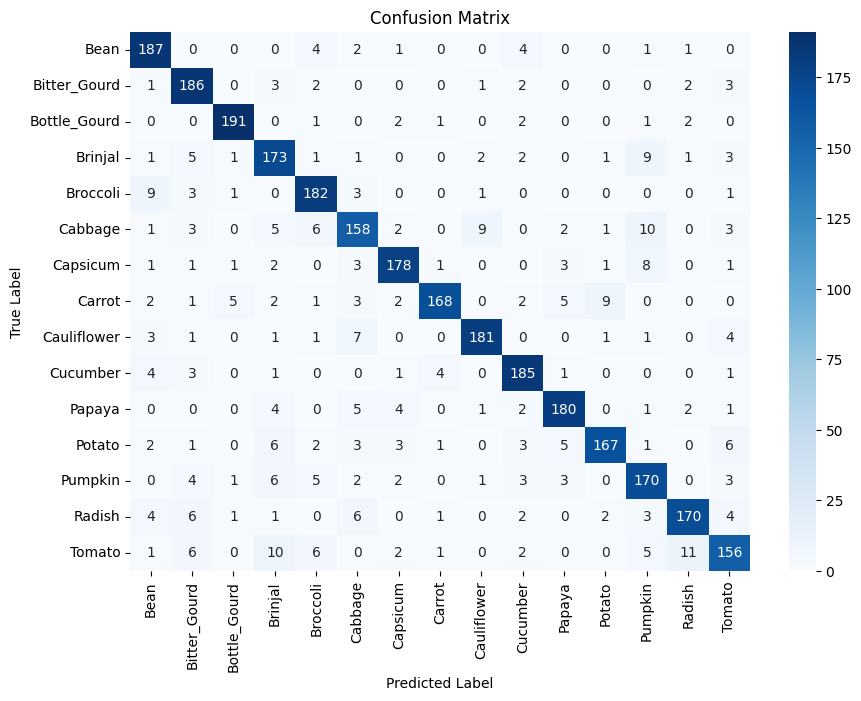

1/1 [==============================] - 0s 297ms/step


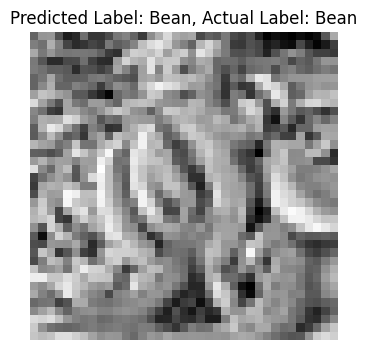

In [25]:
# Set the seed for reproducibility
seed = 88
np.random.seed(seed)
tf.random.set_seed(seed)

# Load the best model
model = load_model('./best_model/best_37x37_model.h5')

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=20, restore_best_weights=True, verbose=1)
history = model.fit(train37, validation_data=val37,epochs=100,callbacks=[early_stopping], verbose=1)

# Final evaluation of the model
scores = model.evaluate(test37, verbose=1)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

# Plot accuracy
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (37x37)')
plt.plot(history.history['val_accuracy'], label='Validation (37x37)')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

# Get the true labels
true_classes = test37.classes

# Predict the output on the test set
predictions = model.predict(test37)
predicted_classes = np.argmax(predictions, axis=1)

# Get the label to class mapping from the generator
class_labels = list(test37.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

# Plot confusion matrix
plot_confusion_matrix(cm, class_labels)

def generate_predictions(test_image_path, actual_label):
    # 1. Load and preprocess the image
    test_img = image.load_img(test_image_path, target_size=(37,37), color_mode='grayscale')
    test_img_arr = image.img_to_array(test_img) / 255.0
    test_img_input = np.expand_dims(test_img_arr, axis=0)  # Add batch dimension

    # 2. Make Predictions

    # Create a dictionary mapping from class index to class name
    class_map = {i: class_name for i, class_name in enumerate(class_labels)}
    predicted_label = np.argmax(model.predict(test_img_input))
    predicted_vegetable = class_map[predicted_label]

    # Display the image and predictions
    plt.figure(figsize=(4, 4))
    plt.imshow(test_img_arr, cmap='gray')
    plt.title(f"Predicted Label: {predicted_vegetable}, Actual Label: {actual_label}")
    plt.grid(False)
    plt.axis('off')
    plt.show()

# Example usage
test_image_path = './Cleaned Dataset for CA1 part A - AY2425S1/test37/Bean/0103.jpg'
actual_label = 'Bean'
generate_predictions(test_image_path, actual_label)

Epoch 1/100
283/283 [==============================] - 29s 101ms/step - loss: 0.3476 - accuracy: 0.9483 - val_loss: 0.4139 - val_accuracy: 0.9323
Epoch 2/100
283/283 [==============================] - 37s 132ms/step - loss: 0.3201 - accuracy: 0.9554 - val_loss: 0.4071 - val_accuracy: 0.9360
Epoch 3/100
283/283 [==============================] - 111s 393ms/step - loss: 0.3365 - accuracy: 0.9502 - val_loss: 0.4171 - val_accuracy: 0.9343
Epoch 4/100
283/283 [==============================] - 111s 393ms/step - loss: 0.3384 - accuracy: 0.9473 - val_loss: 0.4241 - val_accuracy: 0.9327
Epoch 5/100
283/283 [==============================] - 112s 394ms/step - loss: 0.3331 - accuracy: 0.9525 - val_loss: 0.4134 - val_accuracy: 0.9387
Epoch 6/100
283/283 [==============================] - 112s 394ms/step - loss: 0.3419 - accuracy: 0.9524 - val_loss: 0.3991 - val_accuracy: 0.9387
Epoch 7/100
283/283 [==============================] - 112s 394ms/step - loss: 0.3318 - accuracy: 0.9561 - val_loss: 0.3

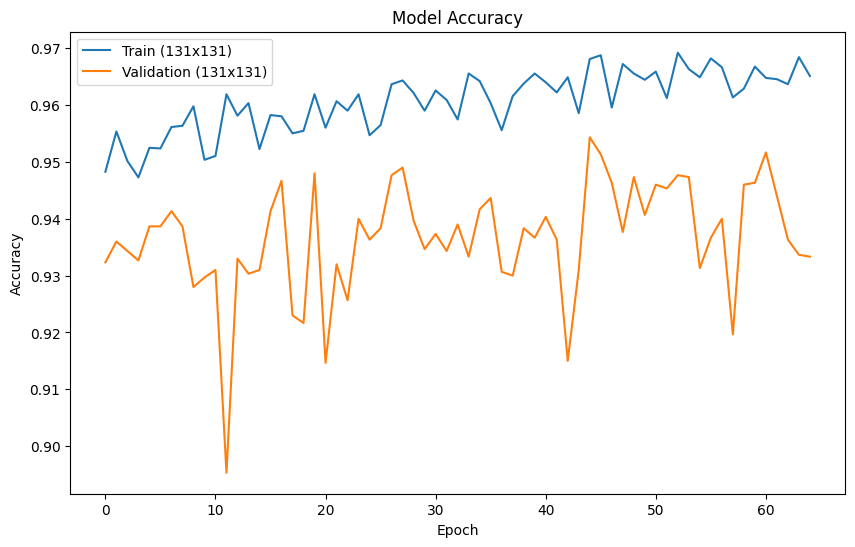

94/94 [==============================] - 2s 22ms/step


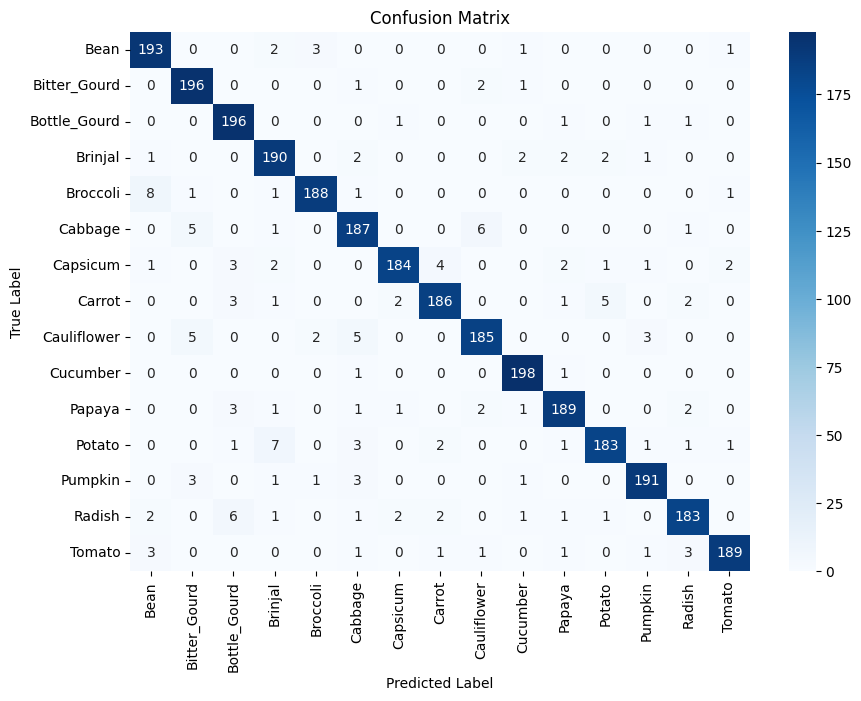

1/1 [==============================] - 0s 85ms/step


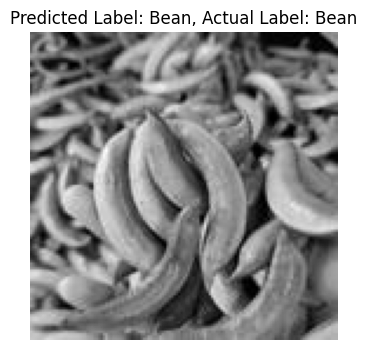

In [28]:
# Load the best model
model = load_model('./best_model/best_131x131_model.h5')

# Define early stopping
early_stopping = EarlyStopping(monitor='val_accuracy', patience=20, restore_best_weights=True, verbose=1)
history = model.fit(train131, validation_data=val131,epochs=100,callbacks=[early_stopping], verbose=1)

# Final evaluation of the model
scores = model.evaluate(test131, verbose=1)
print("CNN Error: %.2f%%" % (100 - scores[1] * 100))

# Plot accuracy
plt.figure(figsize=(10, 6))
plt.plot(history.history['accuracy'], label='Train (131x131)')
plt.plot(history.history['val_accuracy'], label='Validation (131x131)')
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

# Get the true labels
true_classes = test131.classes

# Predict the output on the test set
predictions = model.predict(test131)
predicted_classes = np.argmax(predictions, axis=1)

# Get the label to class mapping from the generator
class_labels = list(test131.class_indices.keys())

# Compute the confusion matrix
cm = confusion_matrix(true_classes, predicted_classes)

# Plot confusion matrix
plot_confusion_matrix(cm, class_labels)

def generate_predictions(test_image_path, actual_label):
    # 1. Load and preprocess the image
    test_img = image.load_img(test_image_path, target_size=(131,131), color_mode='grayscale')
    test_img_arr = image.img_to_array(test_img) / 255.0
    test_img_input = np.expand_dims(test_img_arr, axis=0)  # Add batch dimension

    # 2. Make Predictions

    # Create a dictionary mapping from class index to class name
    class_map = {i: class_name for i, class_name in enumerate(class_labels)}
    predicted_label = np.argmax(model.predict(test_img_input))
    predicted_vegetable = class_map[predicted_label]

    # Display the image and predictions
    plt.figure(figsize=(4, 4))
    plt.imshow(test_img_arr, cmap='gray')
    plt.title(f"Predicted Label: {predicted_vegetable}, Actual Label: {actual_label}")
    plt.grid(False)
    plt.axis('off')
    plt.show()

# Example usage
test_image_path = './Cleaned Dataset for CA1 part A - AY2425S1/test131/Bean/0103.jpg'
actual_label = 'Bean'
generate_predictions(test_image_path, actual_label)